<div class="alert alert-block alert-success">
<h1> DATA MINING - PROJECT </h1>
<h2> Group 19 </h2>
<h3> 20225/2026 </h3>

Student Name - António Parafita <br>
Student id - 20250363 <br>

Student Name - Diogo Montenegro <br>
Student id - 20250491 <br>

Student Name - Francisco <br>
Student id - 20250482 <br>

## **Index**<br>

[1. **Imports**](#1st-bullet)<br>
- [1.1 Import libraries](#2nd-bullet)<br>
- [1.2 Import Data](#3rd-bullet)<br>
    
[2. **Exploratory Analysis**](#4th-bullet)<br>
- [2.1 Minimal Preprocessing](#5th-bullet)<br>
    - [2.1.1 Data Types](#6th-bullet)<br>
    - [2.1.2 Duplicates, Zeros, Nan and Cegative values](#7th-bullet)<br>
    - [2.1.3 New features](#8th-bullet)<br>
    - [2.1.4 New Flights data set aggregated by customer](#9th-bullet)<br>

- [2.2 Univariate Analysis](#10th-bullet)<br>
    - [2.2.1 In-Depth Numerical Analysis](#11th-bullet)<br>
    - [2.2.1.1 Visualization](#12th-bullet)<br>
    - [2.2.2 In-Depth Categorical Analysis](#13th-bullet)<br>
    - [2.2.1.1 Visualization](#14th-bullet)<br>
- [2.3 Bivariate Analysis](#15th-bullet)<br>
    - [2.3.1 Numeric-Numeric](#16th-bullet)<br>
    - [2.3.2 Categorical-Categorical](#17th-bullet)<br>
    - [2.3.3 Numeric-Categorical](#18th-bullet)<br>
        - [2.3.3.1 Seasonality check](#19th-bullet)<br>
- [2.4 Outlier Detection](#20th-bullet)<br>
    

<a class="anchor" id="1st-bullet">    </a>
# 1. Imports

<a class="anchor" id="2st-bullet">    </a>
## 1.1 Import libraries

In [2]:
import sqlite3
import os
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil

from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import IsolationForest
from sklearn.decomposition import PCA

from itertools import product

#maps
import folium
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap
from IPython.display import IFrame

from ydata_profiling import ProfileReport

# for better resolution plots
%config InlineBackend.figure_format = 'retina' # optionally, you can change 'svg' to 'retina'

# Setting seaborn style
sns.set_style("ticks")

<a class="anchor" id="3st-bullet">    </a>
## 1.2 Import Data

In [3]:
customers = pd.read_csv('data/DM_AIAI_CustomerDB.csv', index_col = 0)
flights = pd.read_csv('data/DM_AIAI_FlightsDB.csv')

In [4]:
df_c = customers.copy()

In [5]:
df_f = flights.copy()

<a class="anchor" id="4st-bullet">    </a>
# 2. Exploratory Analysis

In [6]:
df_c.head()

,Loyalty#,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,Postal code,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
0,480934,Cecilia,Householder,Cecilia Householder,Canada,Ontario,Toronto,43.653225,-79.383186,M2Z 4K1,female,Bachelor,Urban,70146.0,Married,Star,2/15/2019,NaN,3839.14,Standard
1,549612,Dayle,Menez,Dayle Menez,Canada,Alberta,Edmonton,53.544388,-113.490930,T3G 6Y6,male,College,Rural,0.0,Divorced,Star,3/9/2019,NaN,3839.61,Standard
2,429460,Necole,Hannon,Necole Hannon,Canada,British Columbia,Vancouver,49.282730,-123.120740,V6E 3D9,male,College,Urban,0.0,Single,Star,7/14/2017,1/8/2021,3839.75,Standard
3,608370,Queen,Hagee,Queen Hagee,Canada,Ontario,Toronto,43.653225,-79.383186,P1W 1K4,male,College,Suburban,0.0,Single,Star,2/17/2016,NaN,3839.75,Standard
4,530508,Claire,Latting,Claire Latting,Canada,Quebec,Hull,45.428730,-75.713364,J8Y 3Z5,male,Bachelor,Suburban,97832.0,Married,Star,10/25/2017,NaN,3842.79,2021 Promotion


In [7]:
df_f.head()

,Loyalty#,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
0,413052,2021,12,12/1/2021,2.0,2.0,9384.0,938.0,0.0,0.0
1,464105,2021,12,12/1/2021,0.0,0.0,0.0,0.0,0.0,0.0
2,681785,2021,12,12/1/2021,10.0,3.0,14745.0,1474.0,0.0,0.0
3,185013,2021,12,12/1/2021,16.0,4.0,26311.0,2631.0,3213.0,32.0
4,216596,2021,12,12/1/2021,9.0,0.0,19275.0,1927.0,0.0,0.0


In [8]:
print(f'The shape of df_c is {df_c.shape}')
print(f'The shape of df_f is {df_f.shape}')

The shape of df_c is (16921, 20)
The shape of df_f is (608436, 10)


In [9]:
df_c.columns

Index(['Loyalty#', 'First Name', 'Last Name', 'Customer Name', 'Country',
       'Province or State', 'City', 'Latitude', 'Longitude', 'Postal code',
       'Gender', 'Education', 'Location Code', 'Income', 'Marital Status',
       'LoyaltyStatus', 'EnrollmentDateOpening', 'CancellationDate',
       'Customer Lifetime Value', 'EnrollmentType'],
      dtype='object')

In [10]:
df_f.columns

Index(['Loyalty#', 'Year', 'Month', 'YearMonthDate', 'NumFlights',
       'NumFlightsWithCompanions', 'DistanceKM', 'PointsAccumulated',
       'PointsRedeemed', 'DollarCostPointsRedeemed'],
      dtype='object')

In [11]:
df_c.info()

<class 'pandas.core.frame.DataFrame'>
Index: 16921 entries, 0 to 19
Data columns (total 20 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Loyalty#                 16921 non-null  int64  
 1   First Name               16921 non-null  object 
 2   Last Name                16921 non-null  object 
 3   Customer Name            16921 non-null  object 
 4   Country                  16921 non-null  object 
 5   Province or State        16921 non-null  object 
 6   City                     16921 non-null  object 
 7   Latitude                 16921 non-null  float64
 8   Longitude                16921 non-null  float64
 9   Postal code              16921 non-null  object 
 10  Gender                   16921 non-null  object 
 11  Education                16921 non-null  object 
 12  Location Code            16921 non-null  object 
 13  Income                   16901 non-null  float64
 14  Marital Status           16921

In [12]:
df_f.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 608436 entries, 0 to 608435
Data columns (total 10 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Loyalty#                  608436 non-null  int64  
 1   Year                      608436 non-null  int64  
 2   Month                     608436 non-null  int64  
 3   YearMonthDate             608436 non-null  object 
 4   NumFlights                608436 non-null  float64
 5   NumFlightsWithCompanions  608436 non-null  float64
 6   DistanceKM                608436 non-null  float64
 7   PointsAccumulated         608436 non-null  float64
 8   PointsRedeemed            608436 non-null  float64
 9   DollarCostPointsRedeemed  608436 non-null  float64
dtypes: float64(6), int64(3), object(1)
memory usage: 46.4+ MB


<a class="anchor" id="5st-bullet">    </a>
## 2.1 Minimal preprocessing

<a class="anchor" id="6st-bullet">    </a>
### 2.1.1 Data types

**Set 'EnrollmentDateOpening', 'CancellationDate' & 'YearMonthDate' type to *datetime***

In [13]:
df_c['EnrollmentDateOpening'] = pd.to_datetime(
    df_c['EnrollmentDateOpening'],
    errors='coerce'
)

df_c['CancellationDate'] = pd.to_datetime(
    df_c['CancellationDate'],
    errors='coerce'
)

df_f['YearMonthDate'] = pd.to_datetime(
    df_f['YearMonthDate'],
    errors='coerce'
)

**Changing data type of numFlights & numFlightsWithCompanions to int**

In [14]:
df_f['NumFlights'] = df_f['NumFlights'].astype(int)
df_f['NumFlightsWithCompanions'] = df_f['NumFlightsWithCompanions'].astype(int)

<a class="anchor" id="7st-bullet">    </a>
### 2.1.2 Duplicates, Zeros, Nan & negative values

**Checking Nan values**

In [15]:
# replace "" by nans
df_c.replace("", np.nan, inplace=True)
# count of missing values
df_c.isna().sum()

Loyalty#                       0
First Name                     0
Last Name                      0
Customer Name                  0
Country                        0
Province or State              0
City                           0
Latitude                       0
Longitude                      0
Postal code                    0
Gender                         0
Education                      0
Location Code                  0
Income                        20
Marital Status                 0
LoyaltyStatus                  0
EnrollmentDateOpening          0
CancellationDate           14613
Customer Lifetime Value       20
EnrollmentType                 0
dtype: int64

In [16]:
# replace "" by nans
df_f.replace("", np.nan, inplace=True)

# count of missing values
df_f.isna().sum()

Loyalty#                    0
Year                        0
Month                       0
YearMonthDate               0
NumFlights                  0
NumFlightsWithCompanions    0
DistanceKM                  0
PointsAccumulated           0
PointsRedeemed              0
DollarCostPointsRedeemed    0
dtype: int64

**Checking for duplicates and dropping them**

In [17]:
df_c.duplicated().sum()

np.int64(0)

In [18]:
df_f.duplicated().sum()

np.int64(2903)

In [19]:
df_f = df_f.drop_duplicates()
df_f.duplicated().sum()

np.int64(0)

— We should drop them because a customer shouldn't have the same month of the same year registered more than once

**Checking if Loyalty# has repeated values**

In [113]:
# How many Loyalty# have duplicates?
print(df_c['Loyalty#'].value_counts()[df_c['Loyalty#'].value_counts() > 1].size)
print(df_f['Loyalty#'].value_counts()[df_f['Loyalty#'].value_counts() > 1].size)

0
16574


In [21]:
#checking if there are extra ids in flights dataset
extra_ids = set(df_f['Loyalty#']) - set(df_c['Loyalty#'])
print( len(extra_ids))

0


In [22]:
#checking how many customer ids don't have flights
ids_without_flights = set(df_c['Loyalty#']) - set(df_f['Loyalty#'])
print( len(ids_without_flights))


20


In [23]:
# 1) Find problematic Loyalty# values in the df_c (appear more than once)
dupe_ids_cust = (
    df_c['Loyalty#']
    .value_counts()
    .loc[lambda s: s > 1]
    .index
)

# 2) Completely remove those values from both datasets
df_c = df_c[~df_c['Loyalty#'].isin(dupe_ids_cust)].copy()
df_f = df_f[~df_f['Loyalty#'].isin(dupe_ids_cust)].copy()

**Checking zeros and negative values**

Customers data set

In [24]:
# Check for zeros in customer dataset
(df_c == 0).sum()

Loyalty#                      0
First Name                    0
Last Name                     0
Customer Name                 0
Country                       0
Province or State             0
City                          0
Latitude                      0
Longitude                     0
Postal code                   0
Gender                        0
Education                     0
Location Code                 0
Income                     4198
Marital Status                0
LoyaltyStatus                 0
EnrollmentDateOpening         0
CancellationDate              0
Customer Lifetime Value       0
EnrollmentType                0
dtype: int64

In [25]:
# Check for negative values in customer dataset
(df_c.select_dtypes(include=['number']) < 0).sum()

Loyalty#                       0
Latitude                       0
Longitude                  16594
Income                         0
Customer Lifetime Value        0
dtype: int64

Flight data set

In [26]:
# Check for zeros in flights dataset
(df_f == 0).sum()

Loyalty#                         0
Year                             0
Month                            0
YearMonthDate                    0
NumFlights                  303071
NumFlightsWithCompanions    447294
DistanceKM                  291496
PointsAccumulated           291496
PointsRedeemed              561780
DollarCostPointsRedeemed    561780
dtype: int64

In [27]:
# Check for negative values in flights dataset
(df_f.select_dtypes(include=['number']) < 0).sum()

Loyalty#                    0
Year                        0
Month                       0
NumFlights                  0
NumFlightsWithCompanions    0
DistanceKM                  0
PointsAccumulated           0
PointsRedeemed              0
DollarCostPointsRedeemed    0
dtype: int64

<a class="anchor" id="8st-bullet">    </a>
### 2.1.3 New features - Days_sub & AvgFlightDistance_month

**"Days_sub" - number of days subscribed in program**

In [28]:

# Converte to datetime
df_c["EnrollmentDateOpening"] = pd.to_datetime(df_c["EnrollmentDateOpening"], errors="coerce")
df_c["CancellationDate"] = pd.to_datetime(df_c["CancellationDate"], errors="coerce")

# Assume that "today" is the last recent date found in dataset
max_date = max(df_c["EnrollmentDateOpening"].max(), df_c["CancellationDate"].max())
print(f"Data mais recente extraída: {max_date}\n")

# Compute difference in days
df_c["Days_sub"] = (
    df_c["CancellationDate"].fillna(max_date) - df_c["EnrollmentDateOpening"]
).dt.days

# If negative value, assume there was a switch of dates 
df_c["Days_sub"] = df_c["Days_sub"].abs()

# Description (no negative value)
print(df_c["Days_sub"].describe())

Data mais recente extraída: 2021-12-30 00:00:00

count    16594.000000
mean      1098.976076
std        737.900363
min          0.000000
25%        389.000000
50%       1015.000000
75%       1744.000000
max       2465.000000
Name: Days_sub, dtype: float64


***AvgFlightDistance_month* — Average distance per flight taken by a customer in a specific month**

In [29]:
df_f['AvgFlightDistance_month'] = np.where(
    df_f['NumFlights'] > 0,
    df_f['DistanceKM'] / df_f['NumFlights'],
    np.nan
)

df_f.sample(10)

,Loyalty#,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed,AvgFlightDistance_month
526320,228030,2019,8,2019-08-01,0,0,0.0,0.0,0.0,0.0,NaN
102699,412402,2021,11,2021-11-01,3,0,15281.0,1528.0,0.0,0.0,5093.666667
145194,257194,2021,10,2021-10-01,0,0,0.0,0.0,0.0,0.0,NaN
251108,374401,2021,3,2021-03-01,3,3,29404.0,2940.0,0.0,0.0,9801.333333
504026,837733,2019,6,2019-06-01,0,0,0.0,0.0,0.0,0.0,NaN
57572,182272,2020,3,2020-03-01,5,5,7140.0,714.0,0.0,0.0,1428.000000
63554,115405,2020,2,2020-02-01,6,0,14463.0,1446.0,0.0,0.0,2410.500000
487425,854077,2019,5,2019-05-01,0,0,0.0,0.0,0.0,0.0,NaN
585906,700145,2019,11,2019-11-01,0,0,0.0,0.0,0.0,0.0,NaN
182827,957912,2021,9,2021-09-01,5,3,27987.0,2798.0,0.0,0.0,5597.400000


<a class="anchor" id="9st-bullet">    </a>
### 2.1.4 Flights dataset aggregated by customer

In [30]:
# Aggregate by client - Loyalty 
df_f_agg = (df_f.groupby("Loyalty#").agg(
    {"Year": ["nunique"],                     
    "Month": ["nunique"],                    
    "NumFlights": ["sum", "mean", "max"],    
    "NumFlightsWithCompanions": ["sum", "mean"],  
    "DistanceKM": ["sum", "mean", "max"],    
    "PointsAccumulated": ["sum", "mean"],    
    "PointsRedeemed": ["sum", "mean"],       
    "DollarCostPointsRedeemed": ["sum", "mean"]}).reset_index())

# I know there are a lot of variables, but u never know if we will use them. In the end, they can be removed
df_f_agg.columns = ["Loyalty#", "Years_Active", "Months_Active", "Flights_Sum", "Flights_Mean", "Flights_Max",
                          "FlightsComp_Sum", "FlightsComp_Mean", "DistKM_Sum", "DistKM_Mean", "DistKM_Max", "PtsAcc_Sum", "PtsAcc_Mean",
                          "PtsRed_Sum", "PtsRed_Mean", "CostPts_Sum", "CostPts_Mean"]

# Feature Engineering (some variables created that could be important)
# Ratio between Points Redeemed and Points Accumulated over the time
df_f_agg["PointsEfficiency"] = (
    df_f_agg["PtsRed_Sum"] / df_f_agg["PtsAcc_Sum"]
).replace([np.inf, np.nan], 0)

# Distance
df_f_agg["DistPerFlight"] = (
    df_f_agg["DistKM_Sum"] / df_f_agg["Flights_Sum"]
).replace([np.inf, np.nan], 0)


In [31]:
df_f_agg

,Loyalty#,Years_Active,Months_Active,Flights_Sum,Flights_Mean,Flights_Max,FlightsComp_Sum,FlightsComp_Mean,DistKM_Sum,DistKM_Mean,DistKM_Max,PtsAcc_Sum,PtsAcc_Mean,PtsRed_Sum,PtsRed_Mean,CostPts_Sum,CostPts_Mean,PointsEfficiency,DistPerFlight
0,100018,3,12,225,6.250000,17,45,1.250000,530230.0,14728.611111,37027.0,53014.30,1472.619444,20562.8,571.188889,201.9,5.608333,0.387873,2356.577778
1,100102,3,12,245,6.805556,15,55,1.527778,339114.6,9419.850000,38726.0,33903.96,941.776667,18760.6,521.127778,186.2,5.172222,0.553345,1384.141224
2,100140,3,12,211,5.861111,15,51,1.416667,432030.8,12000.855556,34715.0,43192.58,1199.793889,4896.0,136.000000,48.0,1.333333,0.113353,2047.539336
3,100214,3,12,108,3.000000,13,17,0.472222,364601.7,10127.825000,33669.0,36453.77,1012.604722,12908.6,358.572222,127.3,3.536111,0.354109,3375.941667
4,100272,3,12,181,5.027778,16,50,1.388889,429630.5,11934.180556,36398.0,42953.25,1193.145833,10891.4,302.538889,107.0,2.972222,0.253564,2373.649171
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16569,999902,3,12,261,7.250000,17,72,2.000000,610159.5,16948.875000,34185.0,61006.55,1694.626389,10501.8,291.716667,103.1,2.863889,0.172142,2337.775862
16570,999911,3,12,0,0.000000,0,0,0.000000,0.0,0.000000,0.0,0.00,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000
16571,999940,3,12,84,2.333333,16,27,0.750000,238578.9,6627.191667,27231.0,23855.59,662.655278,5620.0,156.111111,56.0,1.555556,0.235584,2840.225000
16572,999982,3,12,22,0.611111,11,2,0.055556,52654.0,1462.611111,27622.0,5264.00,146.222222,0.0,0.000000,0.0,0.000000,0.000000,2393.363636


In [32]:
print(df_f_agg['Loyalty#'].is_unique)
print(df_f['Loyalty#'].is_unique)

True
False


In [33]:
print(len(df_f['Loyalty#']))
print(len(df_f_agg['Loyalty#']))

596664
16574


<a class="anchor" id="10st-bullet">    </a>
## 2.2 Univariate Analysis

**Creating set of Metric & non-metric features**

- For customer data set

In [34]:
metric_features_df_c = df_c.select_dtypes(include=['number']).columns.tolist()
metric_features_df_c

['Loyalty#',
 'Latitude',
 'Longitude',
 'Income',
 'Customer Lifetime Value',
 'Days_sub']

In [35]:
non_metric_features_df_c = df_c.columns.drop(metric_features_df_c).to_list()
non_metric_features_df_c

['First Name',
 'Last Name',
 'Customer Name',
 'Country',
 'Province or State',
 'City',
 'Postal code',
 'Gender',
 'Education',
 'Location Code',
 'Marital Status',
 'LoyaltyStatus',
 'EnrollmentDateOpening',
 'CancellationDate',
 'EnrollmentType']

In [36]:
for col in ['Unnamed: 0','Loyalty#', 'Latitude', 'Longitude']:
    if col in metric_features_df_c:
        metric_features_df_c.remove(col)

metric_features_df_c

['Income', 'Customer Lifetime Value', 'Days_sub']

In [37]:
for col in ['Unnamed: 0','Loyalty#', 'Latitude', 'Longitude', 'Postal code', 'EnrollmentDateOpening','CancellationDate','First Name','Last Name','Customer Name']:
    if col in non_metric_features_df_c:
        non_metric_features_df_c.remove(col)

non_metric_features_df_c

['Country',
 'Province or State',
 'City',
 'Gender',
 'Education',
 'Location Code',
 'Marital Status',
 'LoyaltyStatus',
 'EnrollmentType']

- For Flights Data set

In [38]:
metric_features_df_f = df_f.select_dtypes(include=['number']).columns.tolist()
metric_features_df_f

['Loyalty#',
 'Year',
 'Month',
 'NumFlights',
 'NumFlightsWithCompanions',
 'DistanceKM',
 'PointsAccumulated',
 'PointsRedeemed',
 'DollarCostPointsRedeemed',
 'AvgFlightDistance_month']

In [39]:
non_metric_features_df_f = df_f.columns.drop(metric_features_df_f).to_list()
non_metric_features_df_f

['YearMonthDate']

In [40]:
for col in ['Loyalty#','Year','Month']:
    if col in metric_features_df_f:
        metric_features_df_f.remove(col)

metric_features_df_f

['NumFlights',
 'NumFlightsWithCompanions',
 'DistanceKM',
 'PointsAccumulated',
 'PointsRedeemed',
 'DollarCostPointsRedeemed',
 'AvgFlightDistance_month']

- For aggegated Flights Data set

In [41]:
metric_features_agg = df_f_agg.select_dtypes(include=['number']).columns.tolist()

In [42]:
metric_features_agg

['Loyalty#',
 'Years_Active',
 'Months_Active',
 'Flights_Sum',
 'Flights_Mean',
 'Flights_Max',
 'FlightsComp_Sum',
 'FlightsComp_Mean',
 'DistKM_Sum',
 'DistKM_Mean',
 'DistKM_Max',
 'PtsAcc_Sum',
 'PtsAcc_Mean',
 'PtsRed_Sum',
 'PtsRed_Mean',
 'CostPts_Sum',
 'CostPts_Mean',
 'PointsEfficiency',
 'DistPerFlight']

**Creating a new feature called "AvgFlightDistance" (Average flight distance)**

In [43]:
df_f_agg['AvgFlightDistance'] = df_f_agg['DistKM_Sum'] / df_f_agg['Flights_Sum']

In [44]:
for col in ['AvgFlightDistance']:
    if col not in metric_features_agg:
        metric_features_agg.append(col)

metric_features_agg

['Loyalty#',
 'Years_Active',
 'Months_Active',
 'Flights_Sum',
 'Flights_Mean',
 'Flights_Max',
 'FlightsComp_Sum',
 'FlightsComp_Mean',
 'DistKM_Sum',
 'DistKM_Mean',
 'DistKM_Max',
 'PtsAcc_Sum',
 'PtsAcc_Mean',
 'PtsRed_Sum',
 'PtsRed_Mean',
 'CostPts_Sum',
 'CostPts_Mean',
 'PointsEfficiency',
 'DistPerFlight',
 'AvgFlightDistance']

**Set of only "Sum" related metric features**

In [45]:
metric_Sumfeatures_agg = metric_features_agg.copy()

for col in ['Loyalty#',
 'Years_Active',
 'Months_Active',
 'Flights_Mean',
 'Flights_Max',
 'FlightsComp_Mean',
 'DistKM_Mean',
 'DistKM_Max',
 'PtsAcc_Mean',
 'PtsRed_Mean',
 'CostPts_Mean']:
    if col in metric_features_agg:
        metric_Sumfeatures_agg.remove(col)

metric_Sumfeatures_agg 

['Flights_Sum',
 'FlightsComp_Sum',
 'DistKM_Sum',
 'PtsAcc_Sum',
 'PtsRed_Sum',
 'CostPts_Sum',
 'PointsEfficiency',
 'DistPerFlight',
 'AvgFlightDistance']

<a class="anchor" id="11st-bullet">    </a>
### 2.2.1 In-Depth Numerical Analysis

In [46]:
df_c.describe().T

,count,mean,min,25%,50%,75%,max,std
Loyalty#,16594.0,549599.070809,100011.0,326095.25,550237.5,772134.25,999999.0,259190.288366
Latitude,16594.0,47.175405,42.984924,44.231171,46.087818,49.28273,60.721188,3.306935
Longitude,16594.0,-91.830411,-135.05684,-120.23766,-79.383186,-74.596184,-52.712578,22.240055
Income,16574.0,37739.986787,0.0,0.0,34137.0,62373.75,99981.0,30355.907587
EnrollmentDateOpening,16594,2018-10-06 23:49:03.955646720,2015-01-27 00:00:00,2017-01-18 06:00:00,2018-11-02 00:00:00,2020-07-11 00:00:00,2021-12-30 00:00:00,NaN
CancellationDate,2265,2019-12-15 01:30:54.834436864,2015-01-27 00:00:00,2019-01-31 00:00:00,2020-01-13 00:00:00,2021-02-14 00:00:00,2021-12-30 00:00:00,NaN
Customer Lifetime Value,16574.0,7986.494716,1898.01,3978.8225,5780.18,8954.43,83325.38,6858.499179
Days_sub,16594.0,1098.976076,0.0,389.0,1015.0,1744.0,2465.0,737.900363


In [47]:
df_f.describe().T

,count,mean,min,25%,50%,75%,max,std
Loyalty#,596664.0,549435.680825,100018.0,326234.0,550020.0,771901.0,999986.0,258867.195581
Year,596664.0,2020.0,2019.0,2019.0,2020.0,2021.0,2021.0,0.816497
Month,596664.0,6.5,1.0,3.75,6.5,9.25,12.0,3.452055
YearMonthDate,596664,2020-06-16 02:40:00.000000768,2019-01-01 00:00:00,2019-09-23 12:00:00,2020-06-16 00:00:00,2021-03-08 18:00:00,2021-12-01 00:00:00,NaN
NumFlights,596664.0,3.845372,0.0,0.0,0.0,7.0,21.0,5.022941
NumFlightsWithCompanions,596664.0,0.936168,0.0,0.0,0.0,1.0,11.0,1.968412
DistanceKM,596664.0,7973.603444,0.0,0.0,984.5,15400.0,42040.0,10269.174348
PointsAccumulated,596664.0,797.20329,0.0,0.0,98.0,1540.0,4204.0,1026.79392
PointsRedeemed,596664.0,236.469767,0.0,0.0,0.0,0.0,7496.0,985.68037
DollarCostPointsRedeemed,596664.0,2.336869,0.0,0.0,0.0,0.0,74.0,9.749377


**Income**

- 4273 of customers don't have income registered
- possible students or people that don't want to share that information

In [48]:
len(df_c.loc[df_c['Income'] <= 0, 'Income'])

4198

**Days_sub**

- 29 people with 0 days subscribed
- 7 subscribed on the last day
- 22 subscribed and canceled on the same day

In [49]:
len(df_c.loc[df_c['Days_sub'] == 0, 'Days_sub'])

29

In [50]:
#how many people registered on the last day of data extraction
len(df_c.loc[df_c['EnrollmentDateOpening'] == max_date, 'EnrollmentDateOpening'])

7

**Latitude/Longitude**

- None of the cities have weird values for Latitude/Longitude

In [51]:
#check latitude and longitude for every city, compare all entries that have the same city
df_c[['City', 'Latitude', 'Longitude']].groupby('City').agg(['min', 'max'])

Latitude              Longitude            
                      min        max         min         max
City                                                        
Banff           51.178398  51.178398 -115.570800 -115.570800
Calgary         51.048615  51.048615 -114.070850 -114.070850
Charlottetown   46.238239  46.238239  -63.131069  -63.131069
Dawson Creek    55.701475  55.759628 -120.264920 -120.160090
Edmonton        53.524829  53.549353 -113.546357 -113.490930
Fredericton     45.950000  46.029263  -66.652437  -66.565150
Halifax         44.648766  44.648766  -63.575237  -63.575237
Hull            45.428730  45.428730  -75.713364  -75.713364
Kelowna         49.887951  49.887951 -119.496010 -119.496010
Kingston        44.231171  44.231171  -76.485954  -76.485954
London          42.984924  42.984924  -81.245277  -81.245277
Moncton         46.051866  46.106617  -64.825428  -64.714267
Montreal        45.501690  45.573672  -73.567253  -73.523012
Ottawa          45.365906  45.471557  -75.723181  -75.697189
Peace River     56.234180  56.234180 -117.289380 -117.289380
Quebec City     46.749897  46.862970  -71.238050  -71.133444
Regina          50.445210  50.445210 -104.618900 -104.618900
St. John's      47.561508  47.561508  -52.712578  -52.712578
Sudbury         46.522099  46.522099  -80.953033  -80.953033
Thunder Bay     48.380894  48.380894  -89.247681  -89.247681
Toronto         43.593187  43.706878  -79.444335  -79.383186
Tremblant       46.118462  46.118462  -74.596184  -74.596184
Trenton         44.075379  44.101128  -77.576309  -77.550375
Vancouver       49.282730  49.282730 -123.120740 -123.120740
Victoria        48.428421  48.428421 -123.365650 -123.365650
West Vancouver  49.328625  49.328625 -123.160190 -123.160190
Whistler        50.116322  50.116322 -122.957360 -122.957360
Whitehorse      60.721188  60.721188 -135.056840 -135.056840
Winnipeg        49.895138  49.895138  -97.138374  -97.138374

**Year, Month & YearMonthDate**

- YearMonthDate matches with Year & Month

In [52]:
#check if the year and month correspond to the YearMonthDate
mask_year = df_f['YearMonthDate'].dt.year == df_f['Year']
mask_month = df_f['YearMonthDate'].dt.month == df_f['Month']
mask_ok = mask_year & mask_month

print(f"Total rows: {len(df_f)}")
print(f"Rows matching both year and month: {mask_ok.sum()}")
print(f"Rows NOT matching: {(~mask_ok).sum()} ({((~mask_ok).sum()/len(df_f)*100):.2f}%)")


Total rows: 596664
Rows matching both year and month: 596664
Rows NOT matching: 0 (0.00%)


<a class="anchor" id="12st-bullet">    </a>
#### 2.2.1.1 Visualization

**Income, Customer Lifetime Value and Days_sub**

Text(0.5, 1.0, 'Days Subscription')

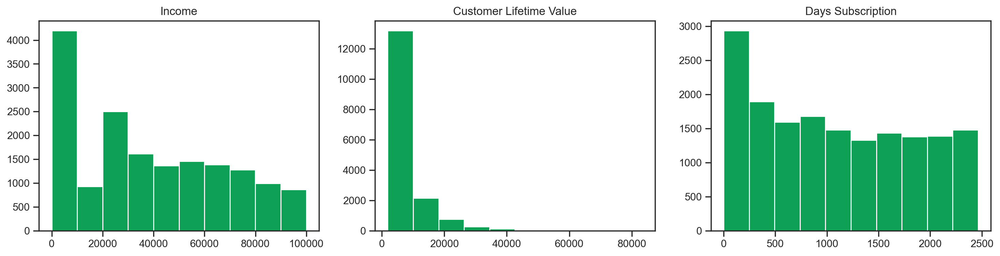

In [53]:
sns.set(style = "ticks")

subplot_rows = 1
subplot_cols = 3
subplot_figsize = (18,4)

fig, axes = plt.subplots(subplot_rows,
                         subplot_cols,
                         figsize = subplot_figsize)

axes[0].hist(df_c['Income'], color = "#0EA155")
axes[1].hist(df_c['Customer Lifetime Value'], color = "#0EA155")
axes[2].hist(df_c['Days_sub'], color = "#0EA155")


axes[0].set_title('Income')
axes[1].set_title('Customer Lifetime Value')
axes[2].set_title('Days Subscription')


Text(0.5, 1.0, 'Days Subscription')

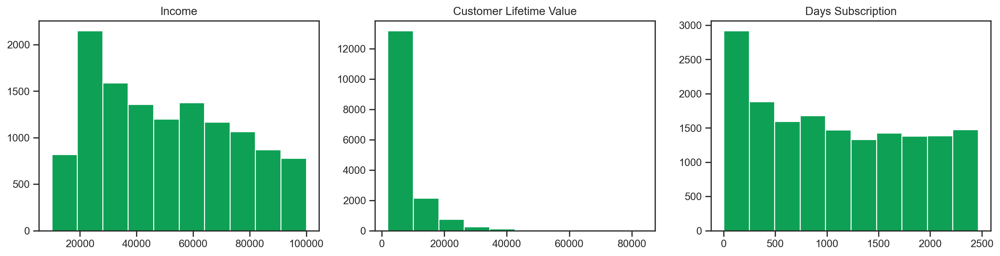

In [54]:
sns.set(style = "ticks")

subplot_rows = 1
subplot_cols = 3
subplot_figsize = (18,4)

fig, axes = plt.subplots(subplot_rows,
                         subplot_cols,
                         figsize = subplot_figsize)

axes[0].hist(df_c['Income'][df_c['Income']>0], color = "#0EA155")
axes[1].hist(df_c['Customer Lifetime Value'][df_c['Customer Lifetime Value']>0], color = "#0EA155")
axes[2].hist(df_c['Days_sub'][df_c['Days_sub']>0], color = "#0EA155")


axes[0].set_title('Income')
axes[1].set_title('Customer Lifetime Value')
axes[2].set_title('Days Subscription')

<Axes: >

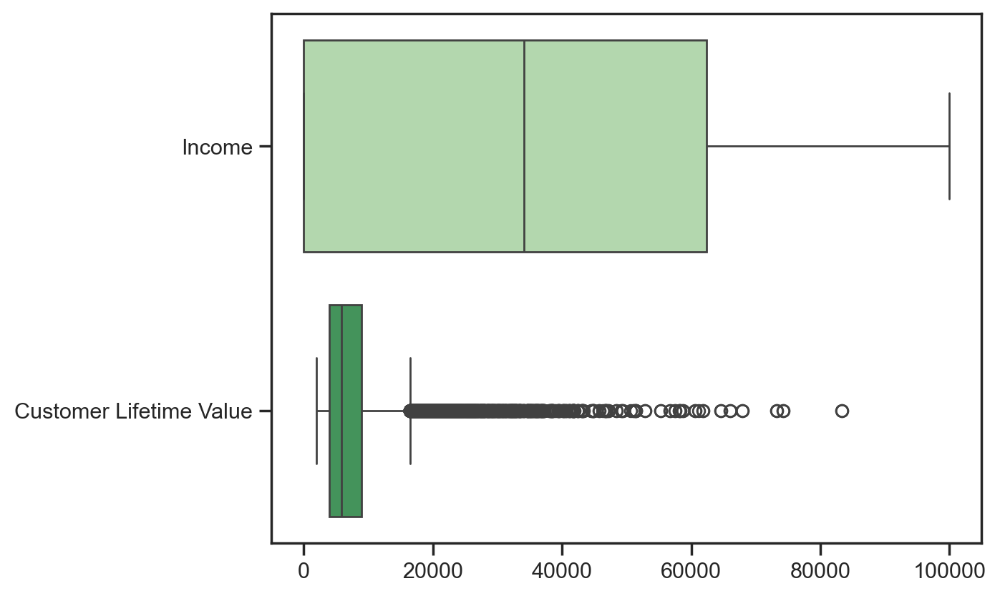

In [55]:
sns.set(style = "ticks")
sns.boxplot(data = df_c[['Income', 'Customer Lifetime Value']],
           orient= 'h',
           palette = "Greens",
           )

<Axes: xlabel='Days_sub'>

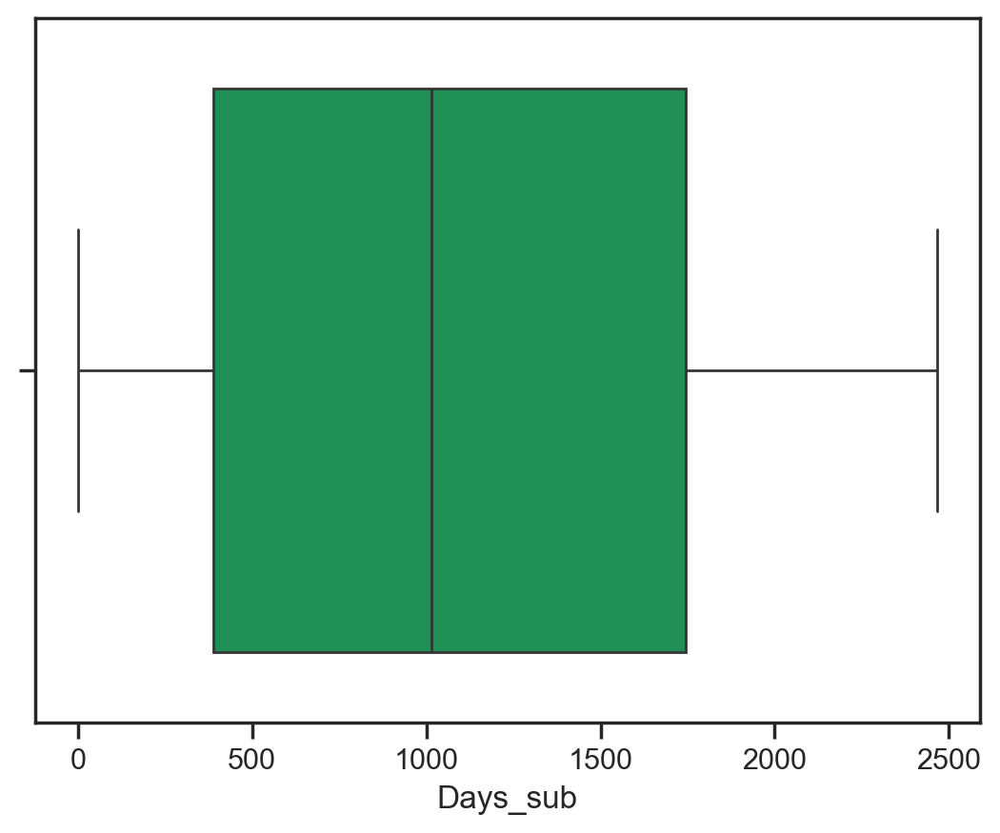

In [56]:
sns.boxplot(data = df_c['Days_sub'],
            orient = 'h',
            color = "#0EA155")

**PointsAccumulated, PointsRedeemed and DistanceKM**


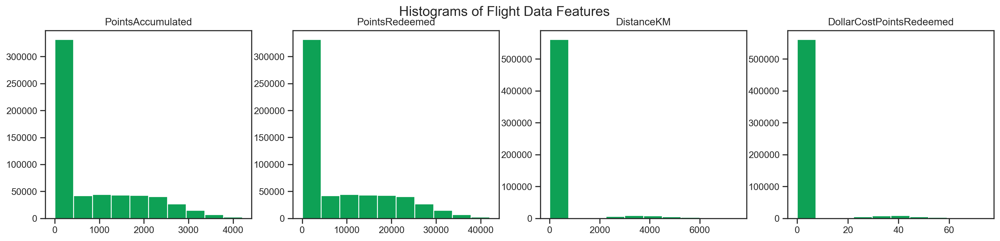

In [57]:
subplot_rows = 1
subplot_cols = 4
subplot_figsize = (20,4) # (width, height)

fig, axes = plt.subplots(subplot_rows,
                         subplot_cols,
                         figsize=subplot_figsize)


axes[0].hist(df_f['PointsAccumulated'], color = "#0EA155")
axes[1].hist(df_f['DistanceKM'], color = "#0EA155")
axes[2].hist(df_f['PointsRedeemed'], color = "#0EA155")
axes[3].hist(df_f['DollarCostPointsRedeemed'], color = "#0EA155")

axes[0].set_title('PointsAccumulated')
axes[1].set_title('PointsRedeemed')
axes[2].set_title('DistanceKM')
axes[3].set_title('DollarCostPointsRedeemed')

plt.suptitle('Histograms of Flight Data Features', fontsize=16)
plt.show()

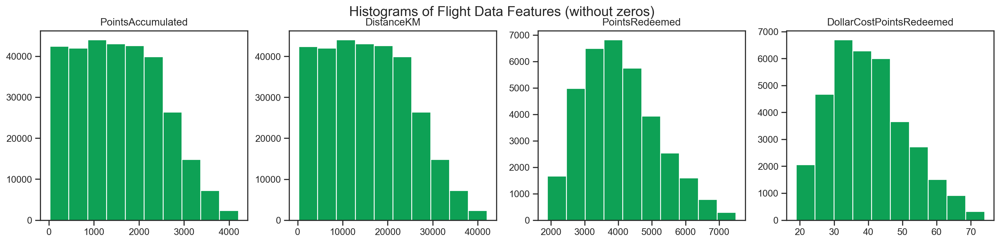

In [58]:
subplot_rows = 1
subplot_cols = 4
subplot_figsize = (20,4) # (width, height)

fig, axes = plt.subplots(subplot_rows,
                         subplot_cols,
                         figsize=subplot_figsize)

#without zeros
axes[0].hist(df_f['PointsAccumulated'][df_f['PointsAccumulated']> 0], color = "#0EA155")
axes[2].hist(df_f['PointsRedeemed'][df_f['PointsRedeemed']> 0], color = "#0EA155")
axes[1].hist(df_f['DistanceKM'][df_f['DistanceKM']> 0], color = "#0EA155")
axes[3].hist(df_f['DollarCostPointsRedeemed'][df_f['DollarCostPointsRedeemed']> 0], color = "#0EA155")

axes[0].set_title('PointsAccumulated')
axes[2].set_title('PointsRedeemed')
axes[1].set_title('DistanceKM')
axes[3].set_title('DollarCostPointsRedeemed')

plt.suptitle('Histograms of Flight Data Features (without zeros)', fontsize=16)
plt.show()

<a class="anchor" id="13st-bullet">    </a>
### 2.2.2 In-Depth Categorical Analysis

In [59]:
df_c.describe(include = 'object').T

,count,unique,top,freq
First Name,16594,4928,Stacey,13
Last Name,16594,15129,Salberg,4
Customer Name,16594,16594,Cecilia Householder,1
Country,16594,1,Canada,16594
Province or State,16594,11,Ontario,5360
City,16594,29,Toronto,3326
Postal code,16594,75,V6E 3D9,906
Gender,16594,2,female,8346
Education,16594,5,Bachelor,10386
Location Code,16594,3,Suburban,5616


In [60]:
df_f.describe().T

,count,mean,min,25%,50%,75%,max,std
Loyalty#,596664.0,549435.680825,100018.0,326234.0,550020.0,771901.0,999986.0,258867.195581
Year,596664.0,2020.0,2019.0,2019.0,2020.0,2021.0,2021.0,0.816497
Month,596664.0,6.5,1.0,3.75,6.5,9.25,12.0,3.452055
YearMonthDate,596664,2020-06-16 02:40:00.000000768,2019-01-01 00:00:00,2019-09-23 12:00:00,2020-06-16 00:00:00,2021-03-08 18:00:00,2021-12-01 00:00:00,NaN
NumFlights,596664.0,3.845372,0.0,0.0,0.0,7.0,21.0,5.022941
NumFlightsWithCompanions,596664.0,0.936168,0.0,0.0,0.0,1.0,11.0,1.968412
DistanceKM,596664.0,7973.603444,0.0,0.0,984.5,15400.0,42040.0,10269.174348
PointsAccumulated,596664.0,797.20329,0.0,0.0,98.0,1540.0,4204.0,1026.79392
PointsRedeemed,596664.0,236.469767,0.0,0.0,0.0,0.0,7496.0,985.68037
DollarCostPointsRedeemed,596664.0,2.336869,0.0,0.0,0.0,0.0,74.0,9.749377


**Province or State**

In [61]:
df_c['Province or State'].unique()

array(['Ontario', 'Alberta', 'British Columbia', 'Quebec',
       'New Brunswick', 'Manitoba', 'Nova Scotia', 'Saskatchewan',
       'Newfoundland', 'Yukon', 'Prince Edward Island'], dtype=object)

**City**

- No problems with city

In [62]:
df_c['City'].unique()

array(['Toronto', 'Edmonton', 'Vancouver', 'Hull', 'Trenton', 'Montreal',
       'Dawson Creek', 'Quebec City', 'Moncton', 'Fredericton', 'Ottawa',
       'Tremblant', 'Calgary', 'Whistler', 'Thunder Bay', 'Peace River',
       'Winnipeg', 'Sudbury', 'West Vancouver', 'Halifax', 'London',
       'Victoria', 'Regina', 'Kelowna', "St. John's", 'Kingston', 'Banff',
       'Whitehorse', 'Charlottetown'], dtype=object)

In [63]:
#checks how many States per city
city_state_counts = df_c.groupby('City')['Province or State'].nunique()
city_state_counts[city_state_counts > 1].sort_values(ascending=False)

Series([], Name: Province or State, dtype: int64)

**Postal code**

- No problems with misplced postal code (in relation to city)

In [64]:
df_c['Postal code'].unique()

array(['M2Z 4K1', 'T3G 6Y6', 'V6E 3D9', 'P1W 1K4', 'J8Y 3Z5', 'P5S 6R4',
       'K8V 4B2', 'H2Y 2W2', 'M8Y 4K8', 'U5I 4F1', 'G1B 3L5', 'H4G 3T4',
       'M2M 7K8', 'M2M 6J7', 'E1A 2A7', 'E3B 2H2', 'M1R 4K3', 'T9G 1W3',
       'H2Y 4R4', 'V5R 1W3', 'P1L 8X8', 'K1F 2R2', 'H5Y 2S9', 'V1E 4R6',
       'H2T 2J6', 'T3E 2V9', 'V6T 1Y8', 'H2T 9K8', 'K8T 5M5', 'P2T 6G3',
       'T9O 2W2', 'V6E 3Z3', 'R6Y 4T5', 'M5V 1G5', 'V6V 8Z3', 'B3J 9S2',
       'M5B 3E4', 'V10 6T5', 'R2C 0M5', 'S6J 3G0', 'M2P 4F6', 'P1J 8T7',
       'V09 2E9', 'A1C 6H9', 'B3C 2M8', 'M9K 2P4', 'T4V 1D4', 'R3R 3T4',
       'S1J 3C5', 'K1G 4Z0', 'Y2K 6R0', 'H3T 8L4', 'C1A 6E8', 'H3J 5I6',
       'M3R 4K8', 'R4H 2Y2', 'N6B 1N3', 'P8F 5C8', 'B6P 6D0', 'X3W 5N2',
       'P6D 6N2', 'W6H 0Z7', 'B2F 3E1', 'B3A 2R0', 'B4W 4M6', 'S5R 0X5',
       'K7T 9I9', 'S7D 0V1', 'E0K 5I2', 'W9D 4Q9', 'Y0C 7D6', 'L3S 9Y3',
       'G2S 2B6', 'B1Z 8T3', 'M4A 1E4'], dtype=object)

In [65]:
#check how many cities per postal code
postal_city_counts = df_c.groupby('Postal code')['City'].nunique()
postal_city_counts[postal_city_counts > 1].sort_values(ascending=False)

Series([], Name: City, dtype: int64)

**Education**

In [66]:
df_c['Education'].unique()

array(['Bachelor', 'College', 'Master', 'High School or Below', 'Doctor'],
      dtype=object)

**Location code**

- It looks random

In [67]:
df_c['Location Code'].unique()

array(['Urban', 'Rural', 'Suburban'], dtype=object)

In [68]:
df_c.loc[df_c['Postal code'] == 'M2M 7K8', ['City','Postal code','Location Code']]

,City,Postal code,Location Code
14,Toronto,M2M 7K8,Rural
102,Toronto,M2M 7K8,Suburban
143,Toronto,M2M 7K8,Urban
157,Toronto,M2M 7K8,Rural
206,Toronto,M2M 7K8,Suburban
...,...,...,...
16776,Toronto,M2M 7K8,Urban
16795,Toronto,M2M 7K8,Urban
16801,Toronto,M2M 7K8,Suburban
16845,Toronto,M2M 7K8,Urban


**Marital Status**

In [69]:
df_c['Marital Status'].unique()

array(['Married', 'Divorced', 'Single'], dtype=object)

**LoyaltyStatus**

In [70]:
df_c['LoyaltyStatus'].unique()

array(['Star', 'Aurora', 'Nova'], dtype=object)

**EnrollmentType**

In [71]:
df_c['EnrollmentType'].unique()

array(['Standard', '2021 Promotion'], dtype=object)

<a class="anchor" id="14st-bullet">    </a>
#### 2.2.2.1 Visualization

**Postal code**

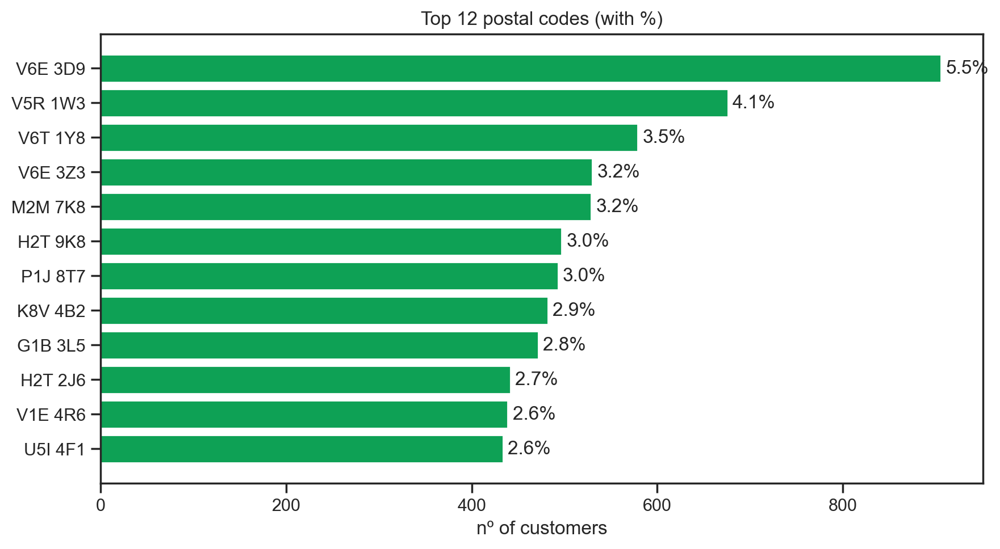

In [72]:
k = 12
vc = df_c["Postal code"].value_counts()
topk = vc.head(k)
topk_pct = (topk / vc.sum() * 100).round(1)

plt.figure(figsize=(9,5))
bars = plt.barh(topk.index[::-1], topk.values[::-1], color = "#0EA155")
plt.xlabel("nº of customers"); plt.title(f"Top {k} postal codes (with %)")
for b, p in zip(bars, topk_pct.values[::-1]):
    plt.text(b.get_width()+5, b.get_y()+b.get_height()/2, f"{p}%", va="center")
plt.tight_layout(); plt.show()

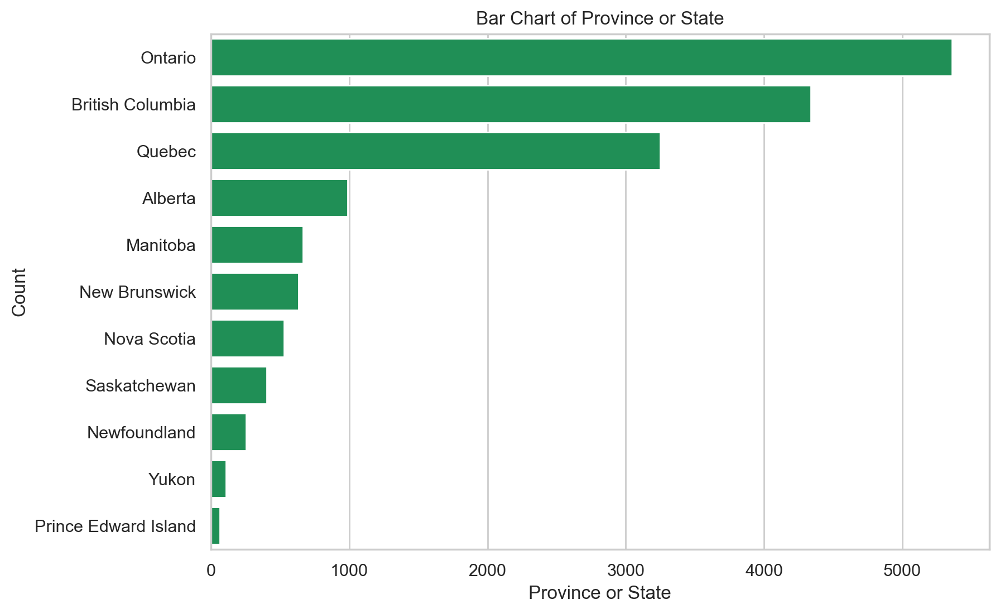

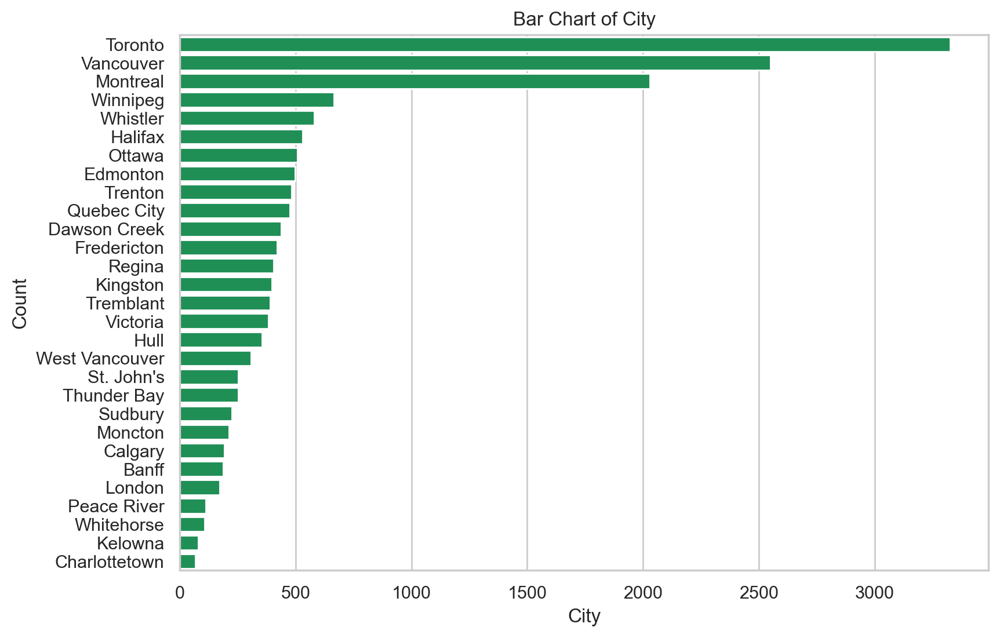

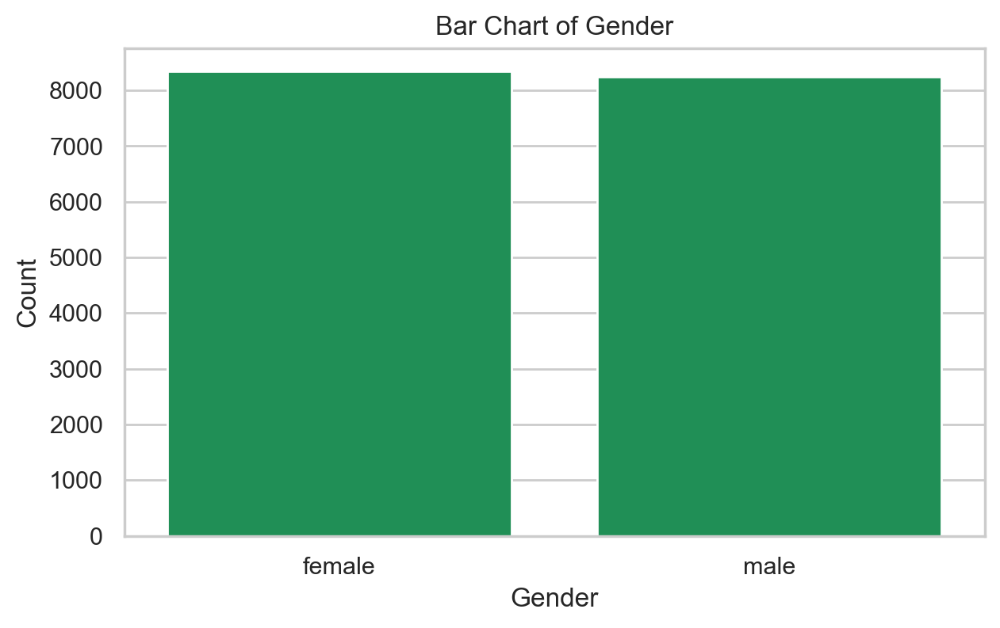

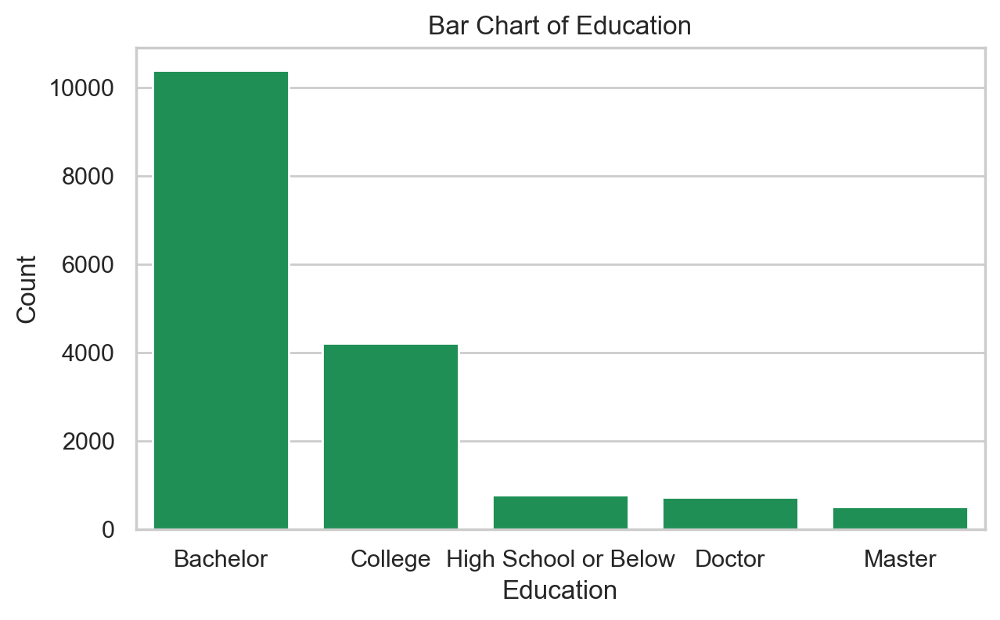

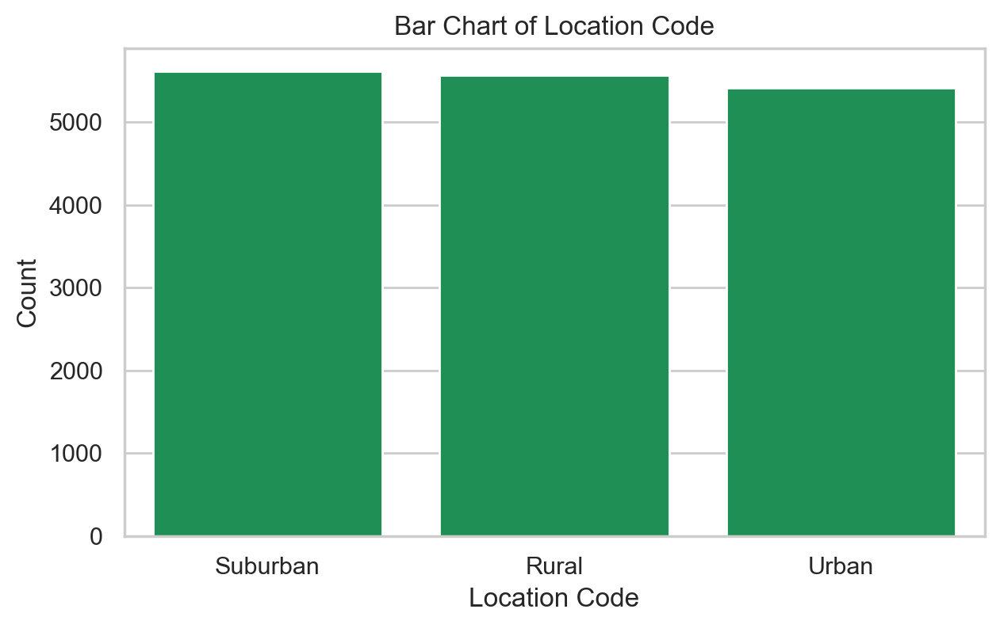

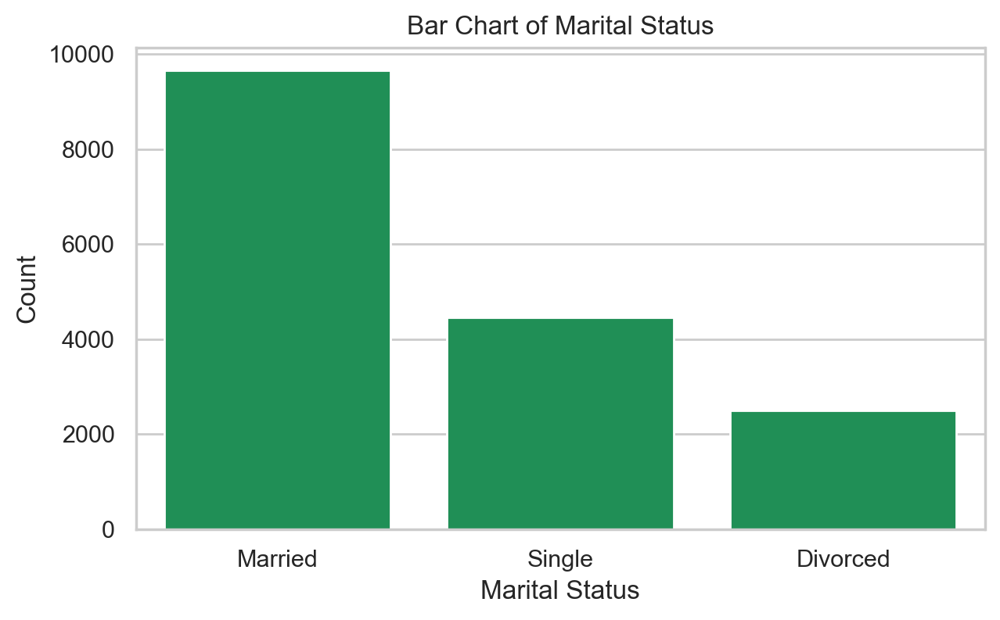

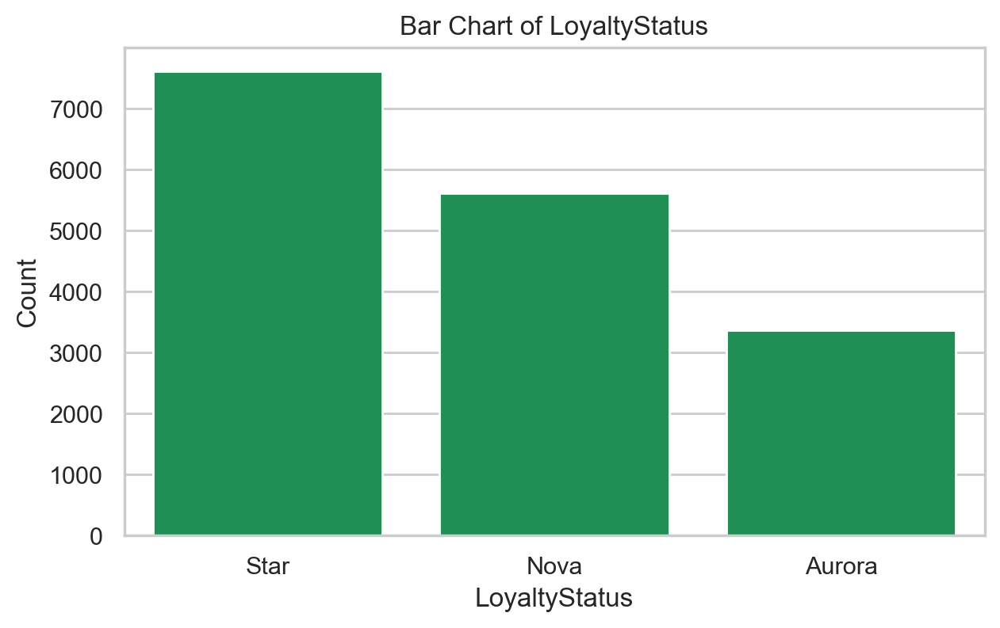

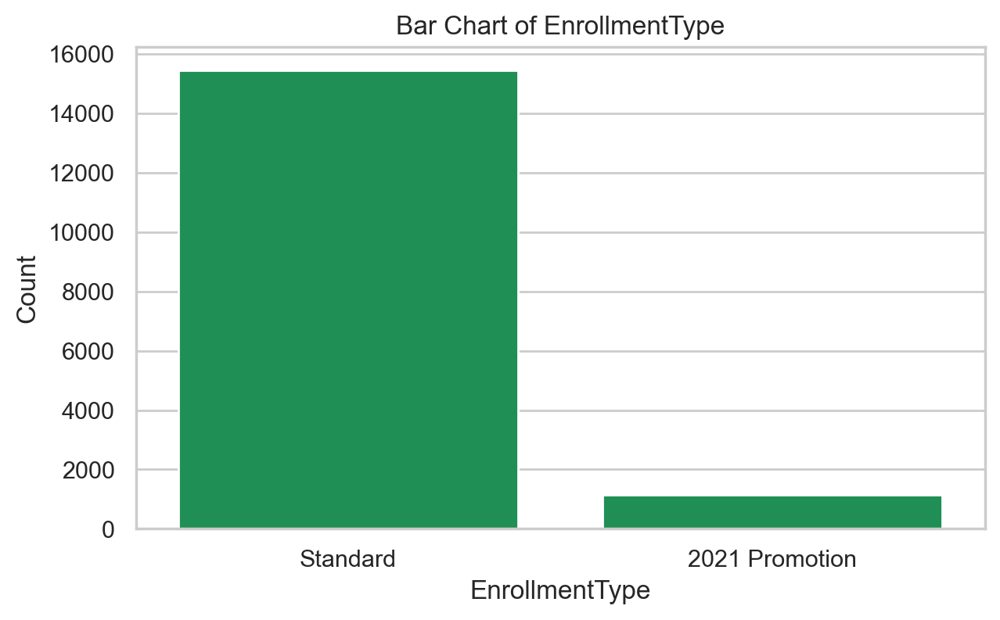

In [73]:
sns.set(style="whitegrid")
    
for feature in non_metric_features_df_c:
    if feature in ['Province or State', 'City']:
         plt.figure(figsize=(9,6))  #we change the size of these figures so we can visualize the labels
         sns.countplot(data=df_c, y=feature, order=df_c[feature].value_counts().index, color = "#0EA155")
         plt.title(f'Bar Chart of {feature}')
         plt.xlabel(feature)
         plt.ylabel('Count')
         plt.show()
         
    if feature not in ['Country', 'Province or State', 'City']:
         plt.figure(figsize=(7,4))  #we change the size of these figures so we can visualize the labels
         sns.countplot(data=df_c, x=feature, order=df_c[feature].value_counts().index, color = "#0EA155")
         plt.title(f'Bar Chart of {feature}')
         plt.xlabel(feature)
         plt.ylabel('Count')
    
    plt.show()

**EnrollmentDateOpening**

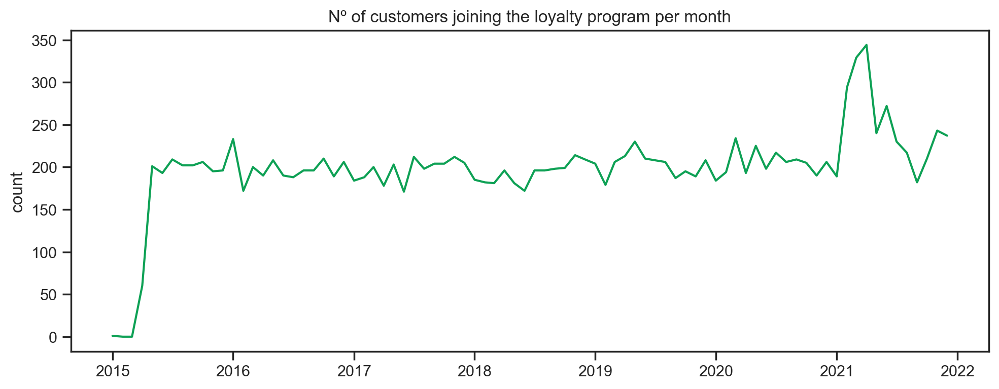

In [74]:
sns.set(style="ticks")
ts = (df_c.set_index('EnrollmentDateOpening').assign(n=1).resample("MS")["n"].sum())

fig, ax = plt.subplots(figsize=(10,4))
ax.plot(ts.index, ts.values, color = '#0EA155')
ax.set_title("Nº of customers joining the loyalty program per month")
ax.set_ylabel("count")
fig.tight_layout()
plt.show()

**CancellationDate**

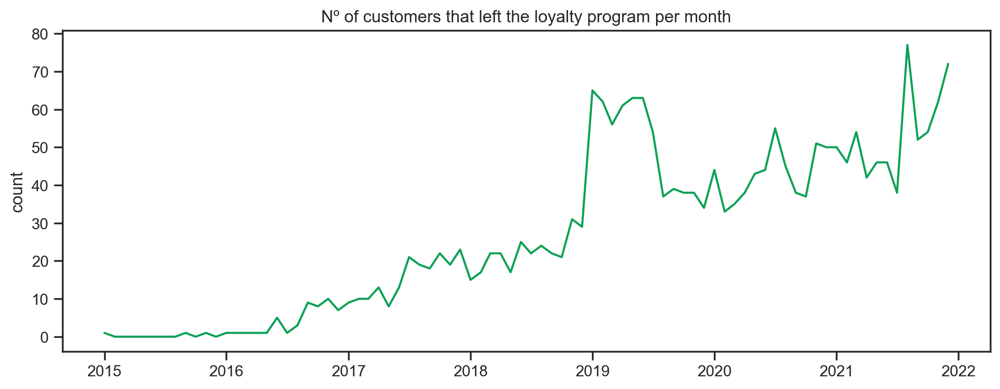

In [75]:
sns.set(style="ticks")
ts = (df_c.set_index('CancellationDate').assign(n=1).resample("MS")["n"].sum())

fig, ax = plt.subplots(figsize=(10,4))
ax.plot(ts.index, ts.values, color = '#0EA155')
ax.set_title("Nº of customers that left the loyalty program per month")
ax.set_ylabel("count")
fig.tight_layout()
plt.show()

Map - Nº os customer per Latitude/Longitude

In [76]:
import folium
from folium.plugins import MarkerCluster

m = folium.Map(location=[df_c["Latitude"].mean(), df_c["Longitude"].mean()],
               zoom_start=4, tiles="cartodbpositron")

mc = MarkerCluster().add_to(m)
for _, r in df_c.iterrows():
    folium.Marker(
        [r["Latitude"], r["Longitude"]],
        tooltip=f'{r["Customer Name"]} – {r["City"]}, {r["Province or State"]}'
    ).add_to(mc)

m.save("customers_points.html")



In [77]:
from IPython.display import IFrame
IFrame("customers_points.html", width=900, height=600)

In [78]:
from folium.plugins import HeatMap
m = folium.Map(location=[df_c["Latitude"].mean(), df_c["Longitude"].mean()],
               zoom_start=4, tiles="cartodbpositron")
HeatMap(df_c[["Latitude","Longitude"]].values.tolist(), radius=16).add_to(m)
m.save("customers_heatmap.html")


In [79]:
from IPython.display import IFrame
IFrame("customers_heatmap.html", width=900, height=600)

<a class="anchor" id="15st-bullet">    </a>
## 2.3 Bivariate Analysis

<a class="anchor" id="17st-bullet">    </a>
### 2.3.1 Numeric-Numeric

**hexagon binning between Income and Customer Lifetime Value**

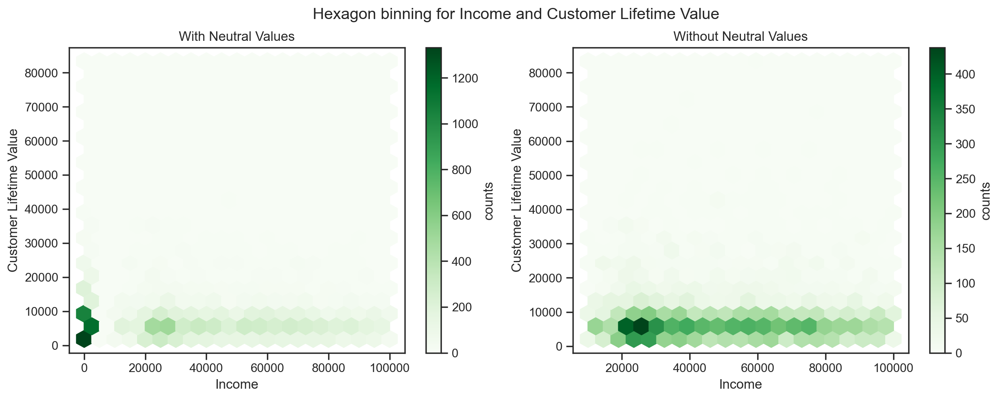

In [80]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

#with neutral values
hb1 = ax1.hexbin(df_c["Income"], df_c["Customer Lifetime Value"], 
                 gridsize=20, cmap = 'Greens')
ax1.set_title("With Neutral Values")
cb1 = fig.colorbar(hb1, ax=ax1, label='counts')

#without neutral values
df_valid = df_c[
    (df_c['Income'] > 0) &
    (df_c['Customer Lifetime Value'] > 0)]
hb2 = ax2.hexbin(df_valid["Income"], df_valid["Customer Lifetime Value"], 
                 gridsize=20, cmap = 'Greens')
ax2.set_title("Without Neutral Values")
cb2 = fig.colorbar(hb2, ax=ax2, label='counts') 
# axis labels
for ax in (ax1, ax2):
    ax.set_xlabel("Income")
    ax.set_ylabel("Customer Lifetime Value")

title= "Hexagon binning for Income and Customer Lifetime Value"
plt.suptitle(title)

plt.show()

**Relation between Customer Lifetime Value and ProgramAge**

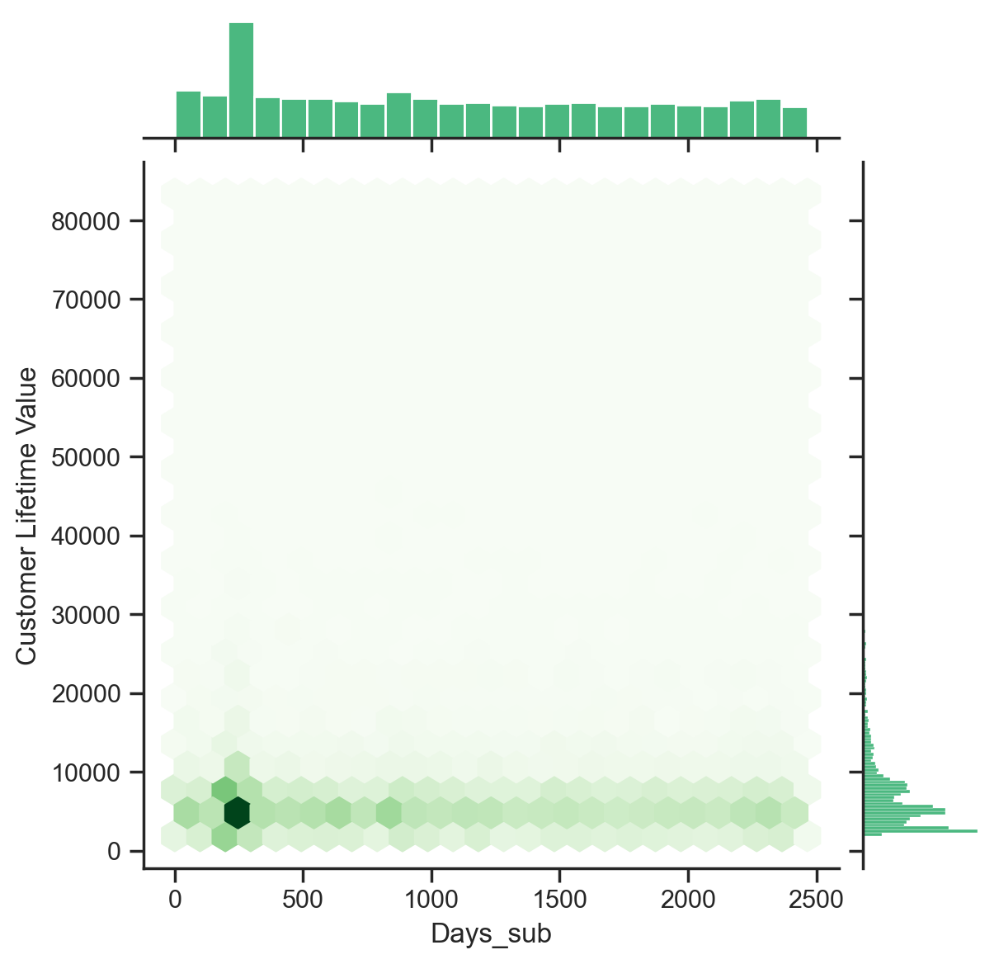

In [81]:
sns.set_style("ticks")
sns.jointplot(data=df_c, y="Customer Lifetime Value", x="Days_sub", kind="hex", cmap = 'Greens', color = '#0EA155', gridsize = 25)
plt.show()

**Pairwise Relationship between Numerical Variables**

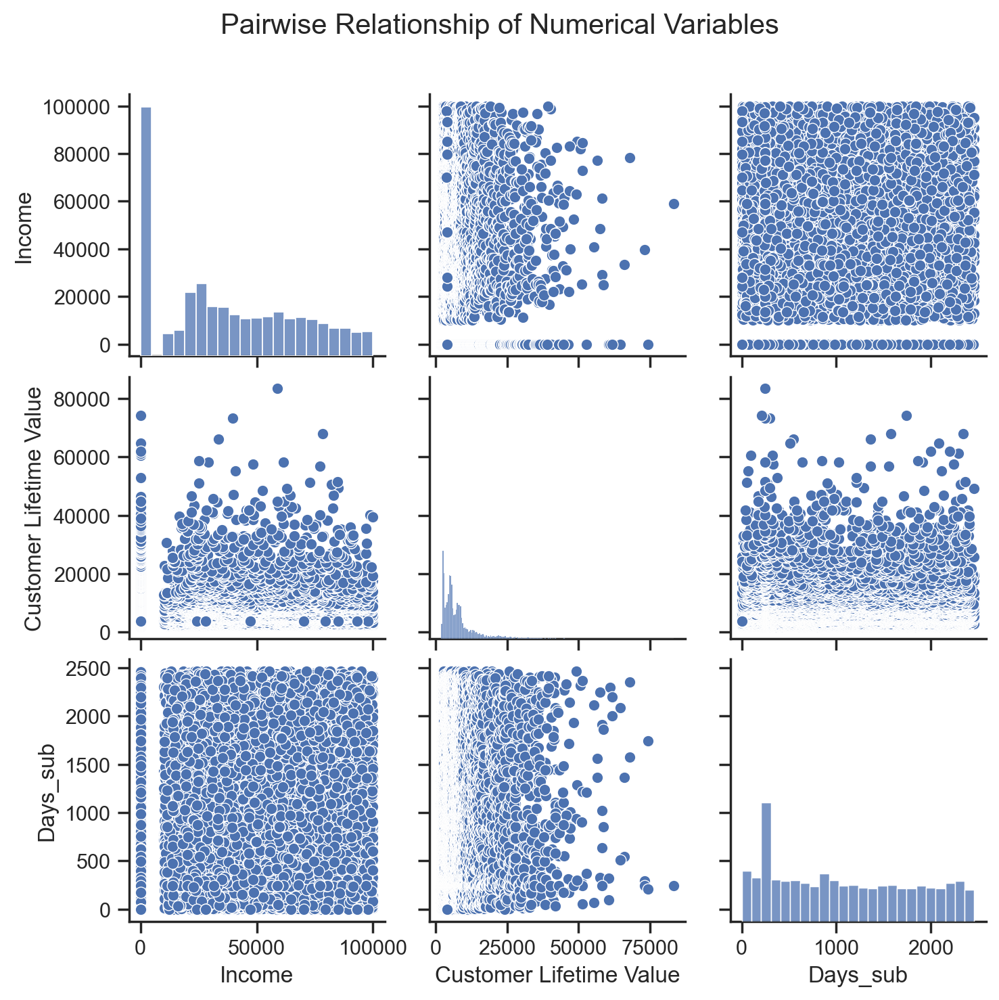

In [82]:
####
sns.pairplot(df_c[metric_features_df_c], diag_kind="hist")
####

plt.subplots_adjust(top=0.90)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=15)
plt.show()

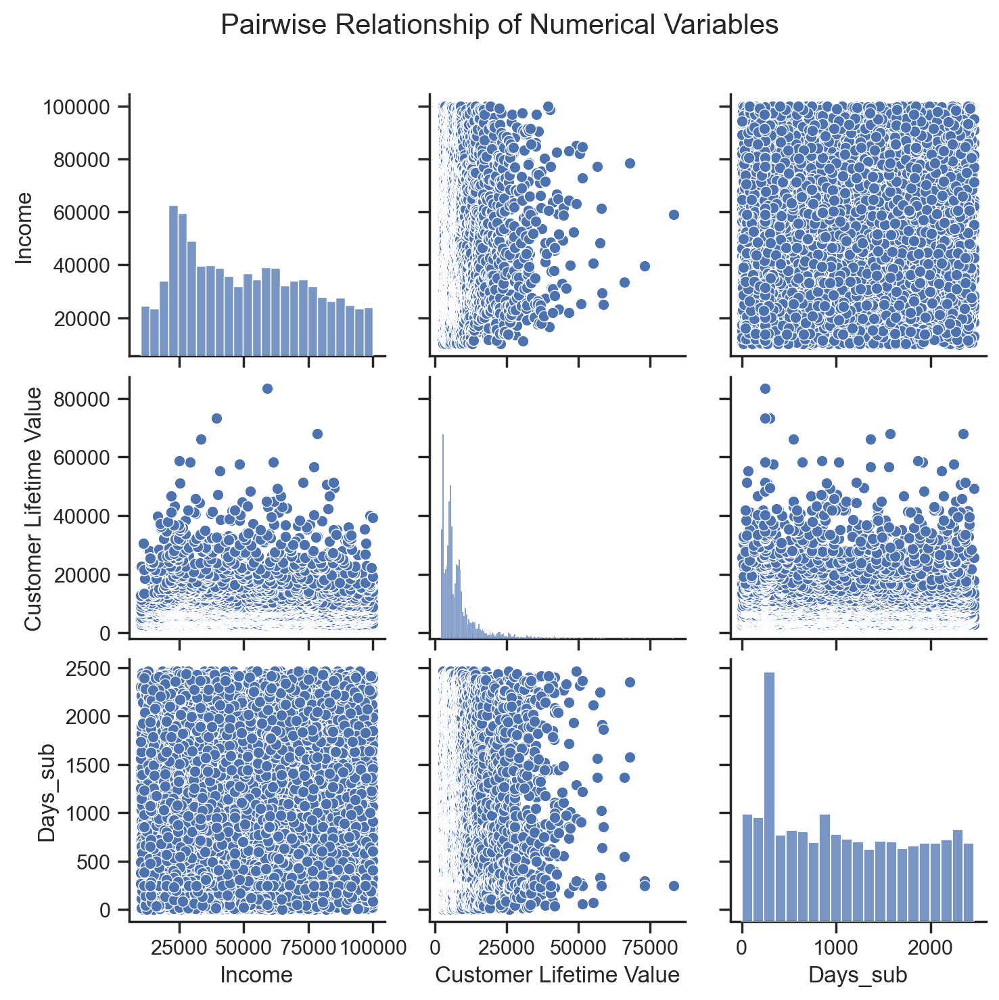

In [83]:
#now without negative/neutral values

df_valid3 = df_c[metric_features_df_c]
df_valid3 = df_valid3[(df_valid3 > 0).all(axis=1)]

####
sns.pairplot(df_valid3[metric_features_df_c], diag_kind="hist")
####

plt.subplots_adjust(top=0.90)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=15)
plt.show()

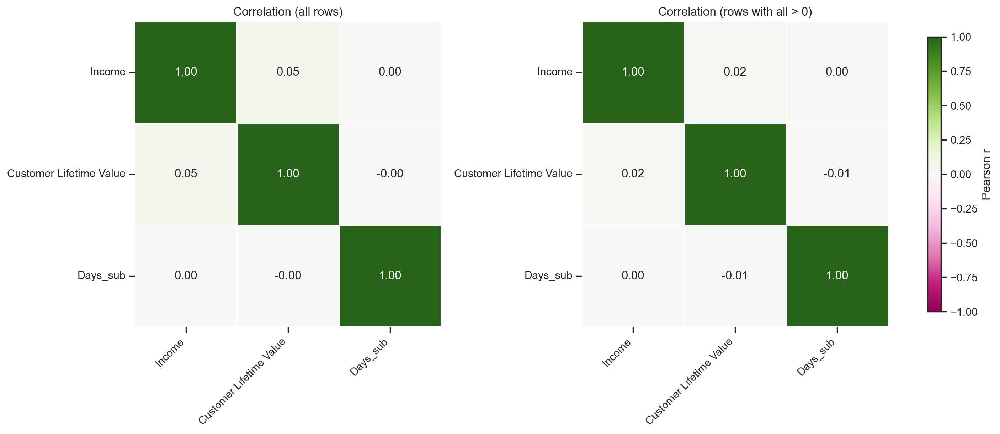

In [84]:

cols = metric_features_df_c  # e.g., ["Income", "Customer Lifetime Value", "ProgramAge"]

# Correlations
corr1 = df_c[cols].corr(method="spearman")

df_valid4 = df_c[cols]
df_valid4 = df_valid4[df_valid4.gt(0).all(axis=1)]   # keep rows with all > 0
corr2 = df_valid4[cols].corr(method="spearman")

fig, axes = plt.subplots(1, 2, figsize=(14, 6), constrained_layout=True)

hm1 = sns.heatmap(
    corr1, ax=axes[0], annot=True, fmt=".2f",
    vmin=-1, vmax=1, center=0, cmap="PiYG",
    square=True, linewidths=.5, cbar=False
)
axes[0].set_title("Correlation (all rows)")

hm2 = sns.heatmap(
    corr2, ax=axes[1], annot=True, fmt=".2f",
    vmin=-1, vmax=1, center=0, cmap="PiYG",
    square=True, linewidths=.5, cbar=False
)
axes[1].set_title("Correlation (rows with all > 0)")

cbar = fig.colorbar(hm1.collections[0], ax=axes, shrink=0.9, location="right")
cbar.set_label("Pearson r")

for ax in axes:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0)

plt.show()


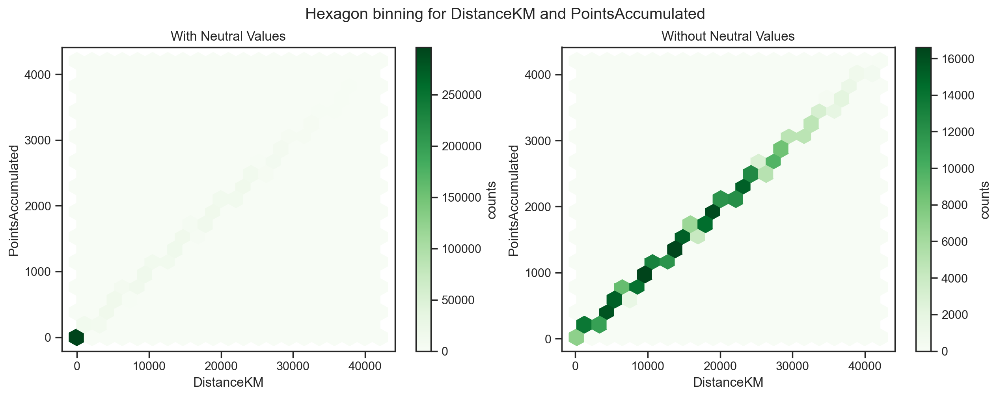

In [85]:
#put these above side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

#with neutral values
hb1 = ax1.hexbin(df_f["DistanceKM"], df_f["PointsAccumulated"], 
                 gridsize=20, cmap = 'Greens')
ax1.set_title("With Neutral Values")
cb1 = fig.colorbar(hb1, ax=ax1, label='counts')

#without neutral values
df_valid5 = df_f[
    (df_f['PointsAccumulated'] > 0) &
    (df_f['DistanceKM'] > 0)]

hb2 = ax2.hexbin(df_valid5["DistanceKM"], df_valid5["PointsAccumulated"], 
                 gridsize=20, cmap = 'Greens')
ax2.set_title("Without Neutral Values")
cb2 = fig.colorbar(hb2, ax=ax2, label='counts')
# axis labels
for ax in (ax1, ax2):
    ax.set_xlabel("DistanceKM")
    ax.set_ylabel("PointsAccumulated") 
title= "Hexagon binning for DistanceKM and PointsAccumulated"
plt.suptitle(title) 
plt.show()


**Pairwise Relationship of Numerical Variables**

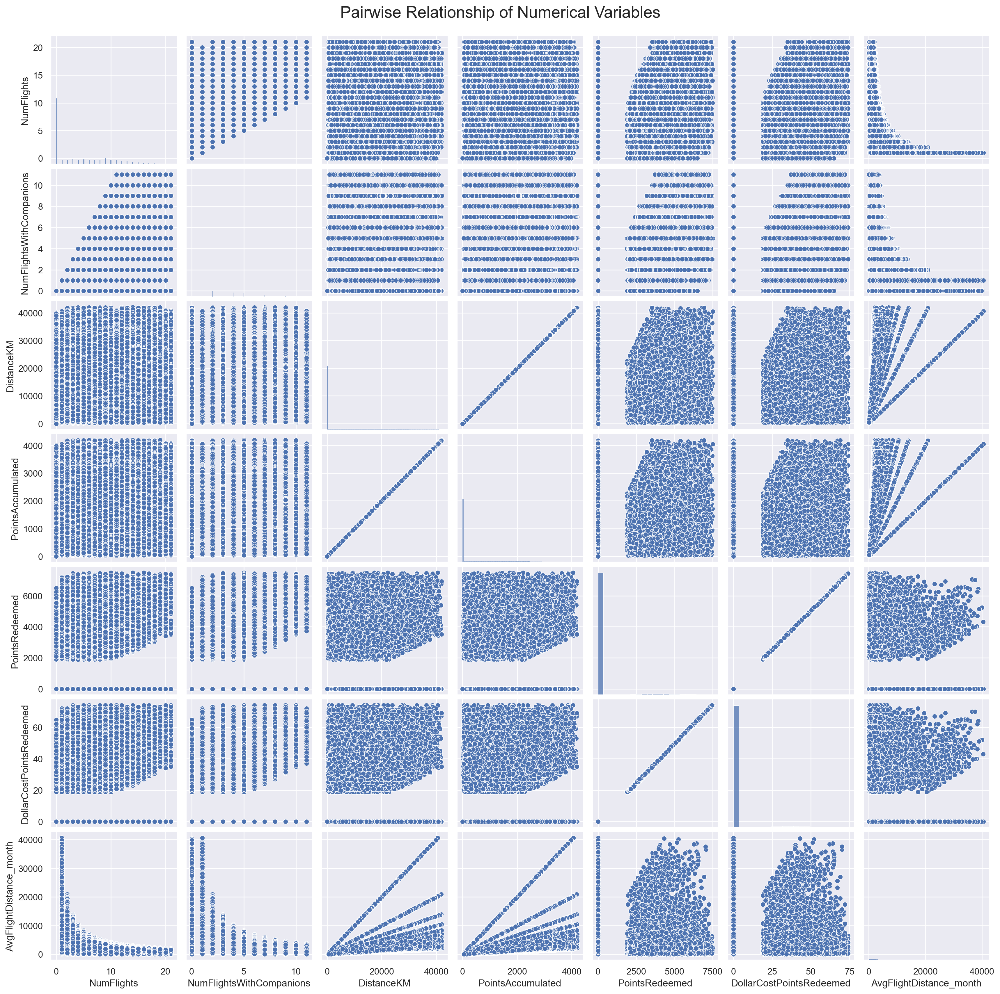

In [86]:
sns.set()

####
sns.pairplot(df_f[metric_features_df_f], diag_kind="hist")
####

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)
plt.show()

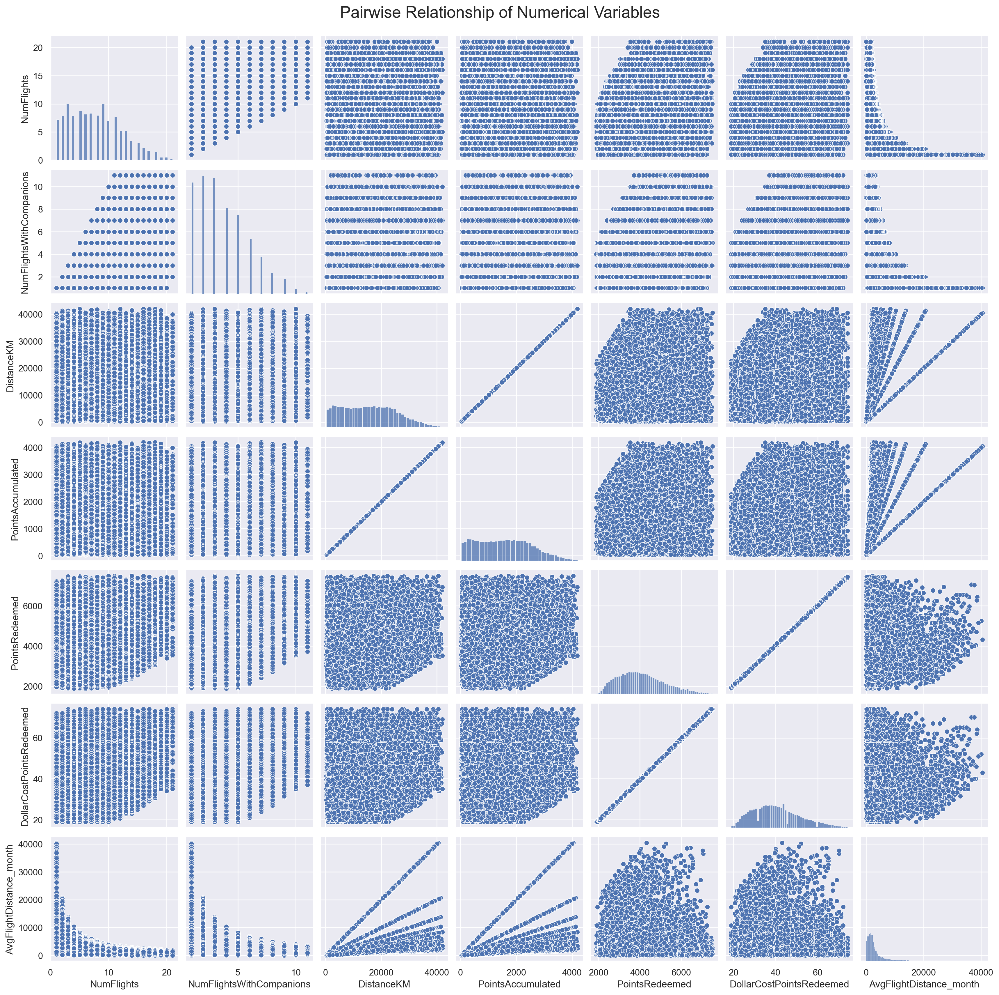

In [87]:
#w/o neutral values
df_valid7 = df_f[metric_features_df_f]
df_valid7 = df_valid7[(df_valid7 > 0).all(axis=1)]

sns.set()

####
sns.pairplot(df_valid7[metric_features_df_f], diag_kind="hist")
####

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)
plt.show()

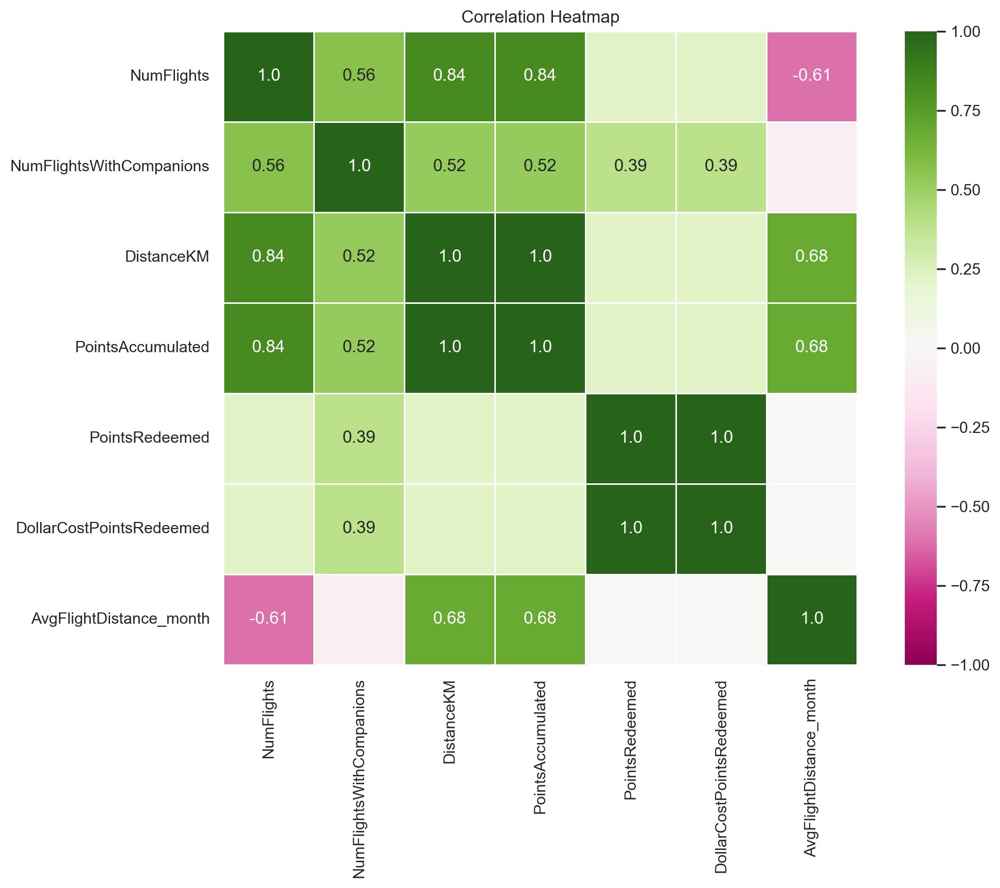

In [88]:
corr4 = df_f[metric_features_df_f].corr(method="spearman")

fig = plt.figure(figsize=(12, 8))
plt.title("Correlation Heatmap")

threshold = 0.3

annot = corr4.round(2).astype(str)
annot_masked = annot.where(corr4.abs() >= threshold, '') 

sns.heatmap(data=corr4, 
            annot=annot_masked, 
            fmt='s', 
            vmin=-1, vmax=1, 
            center=0, 
            square=True, 
            linewidths=.5, 
            cmap='PiYG' 
            )

plt.show()

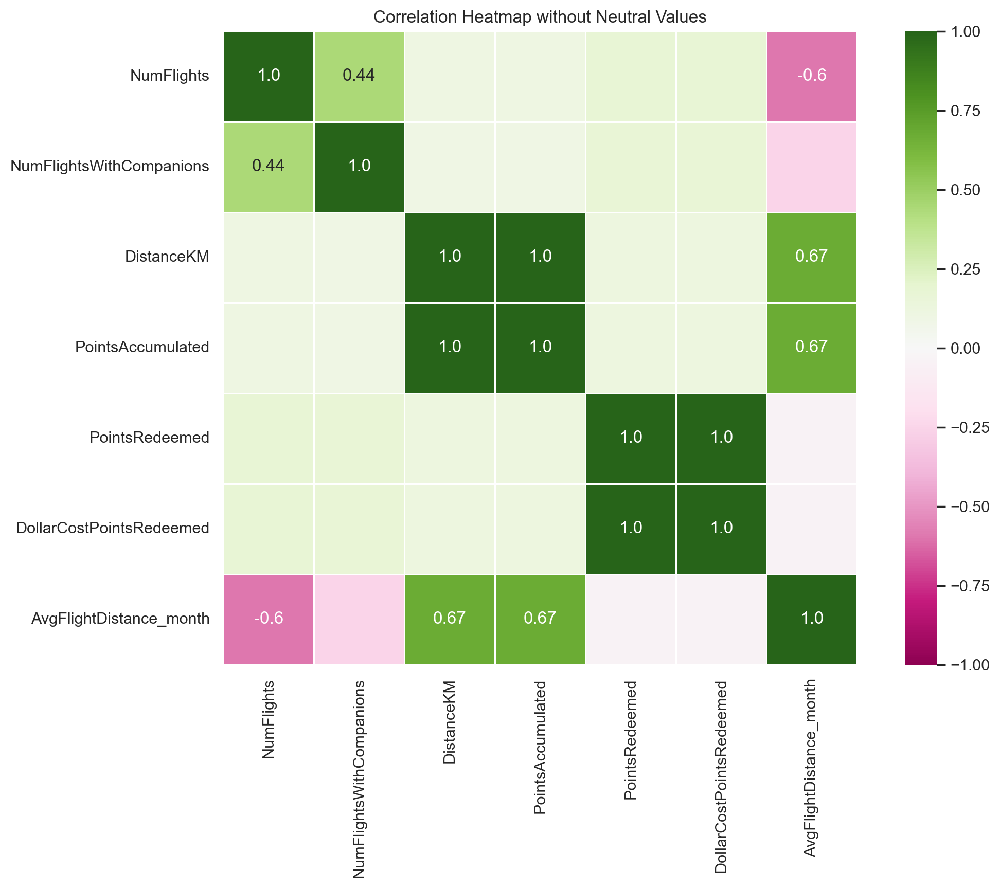

In [89]:
df_valid9 = df_f[metric_features_df_f]
df_valid9 = df_valid9[(df_valid9 > 0).all(axis=1)]

corr4_new = df_valid9[metric_features_df_f].corr(method="spearman")

fig = plt.figure(figsize=(12, 8))
plt.title("Correlation Heatmap without Neutral Values")

threshold = 0.3

annot = corr4_new.round(2).astype(str)
annot_masked = annot.where(corr4_new.abs() >= threshold, '') 

sns.heatmap(data=corr4_new, 
            annot=annot_masked, 
            fmt='s', 
            vmin=-1, vmax=1, 
            center=0, 
            square=True, 
            linewidths=.5, 
            cmap='PiYG' 
            )

plt.show()

**Aggregated Flights Set by customer**

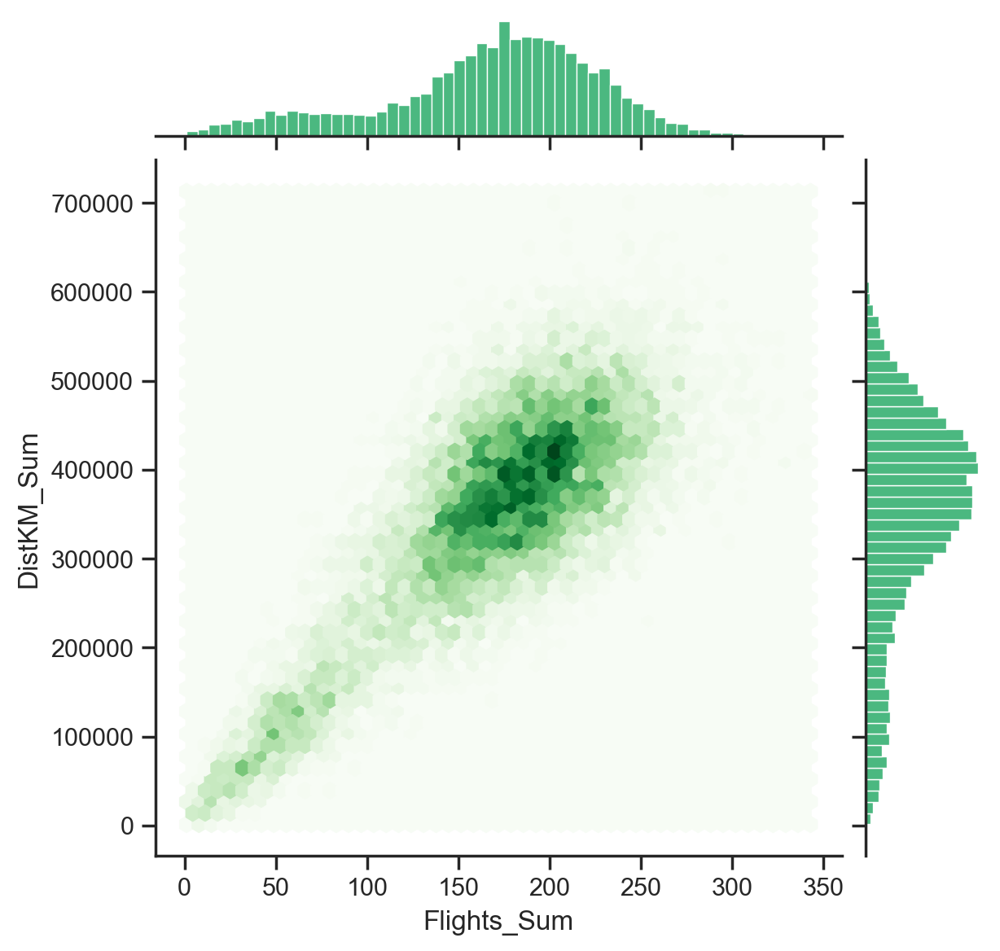

In [90]:
df_valid_agg = df_f_agg[metric_features_agg]
df_valid_agg = df_valid_agg[(df_valid_agg > 0).all(axis=1)]

sns.set(style="ticks")
sns.jointplot(data=df_valid_agg, x="Flights_Sum", y="DistKM_Sum", kind="hex", cmap = "Greens", color = '#0EA155')
plt.show()

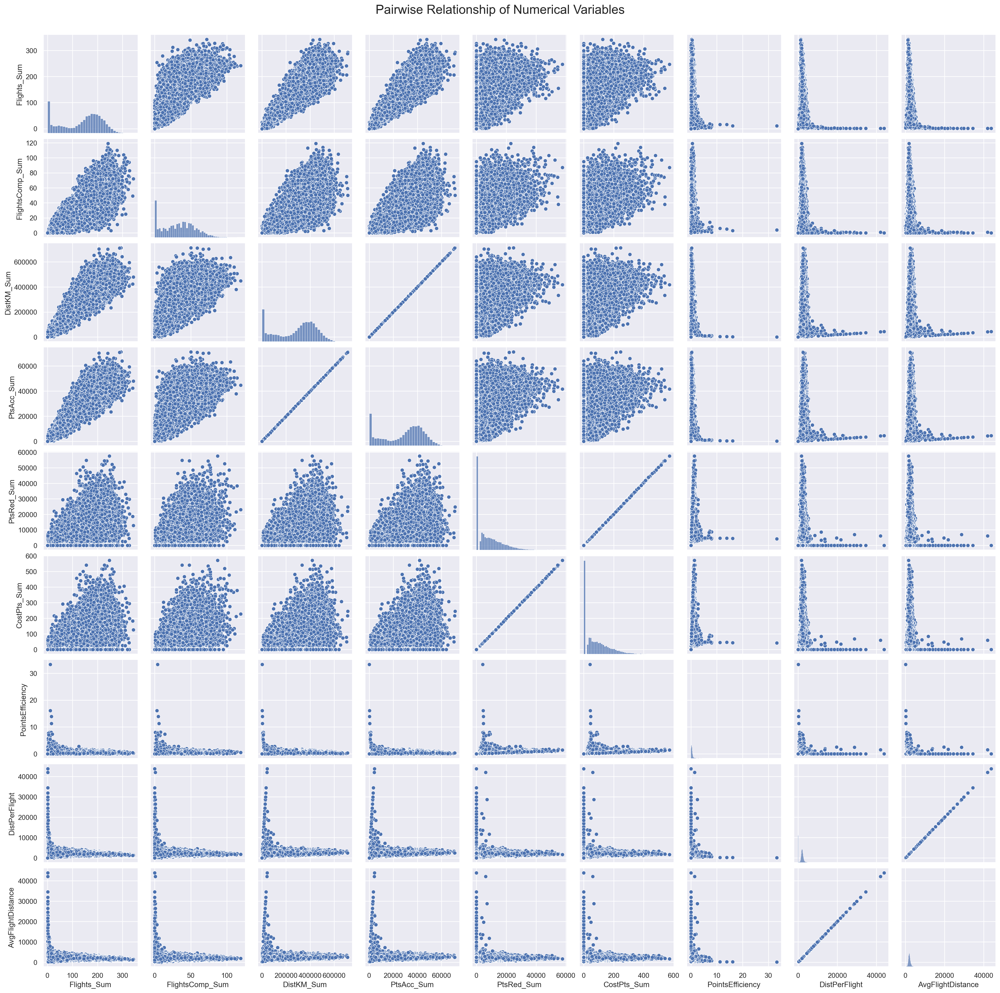

In [91]:
sns.set()

####
sns.pairplot(df_f_agg[metric_Sumfeatures_agg], diag_kind="hist")
####

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)
plt.show()

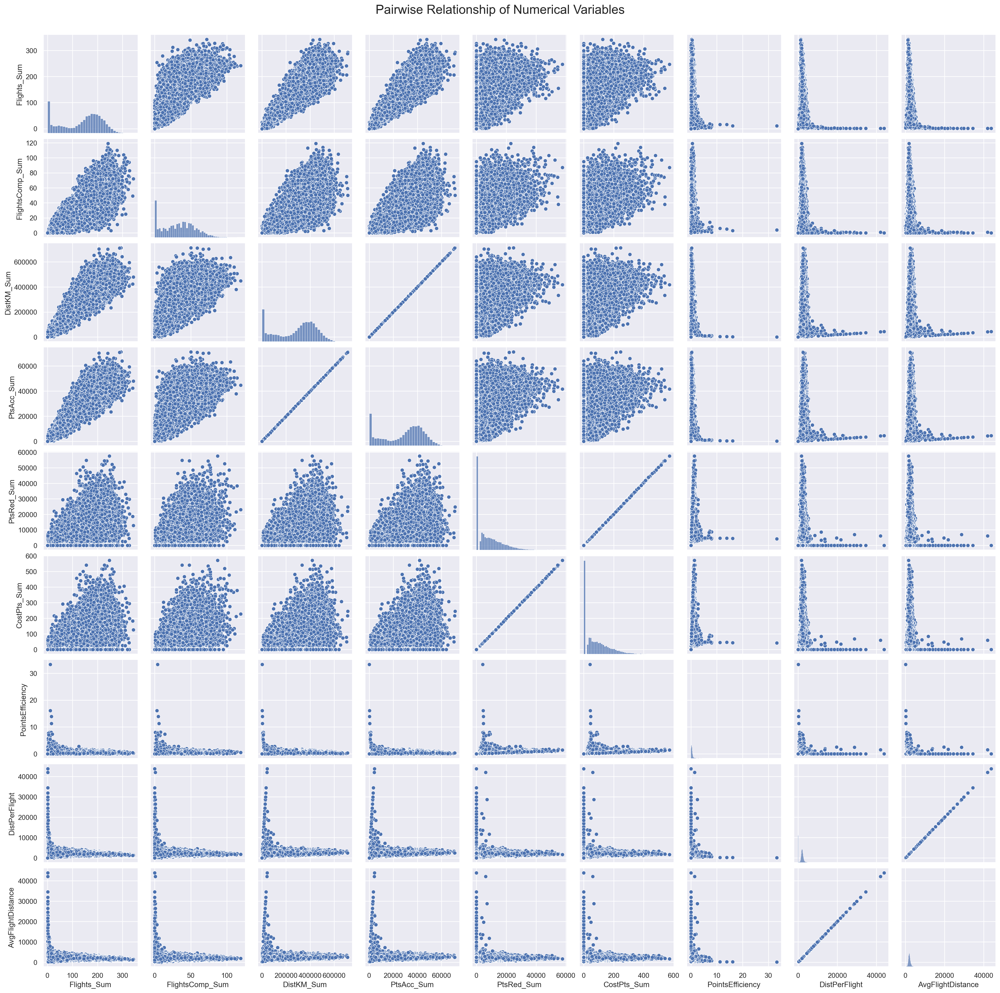

In [92]:
#now without negative/neutral values

df_valid_agg = df_f_agg[metric_Sumfeatures_agg]
df_valid_agg = df_valid_agg[(df_valid_agg > 0).all(axis=1)]

sns.set()

####
sns.pairplot(df_f_agg[metric_Sumfeatures_agg], diag_kind="hist")
####

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)
plt.show()

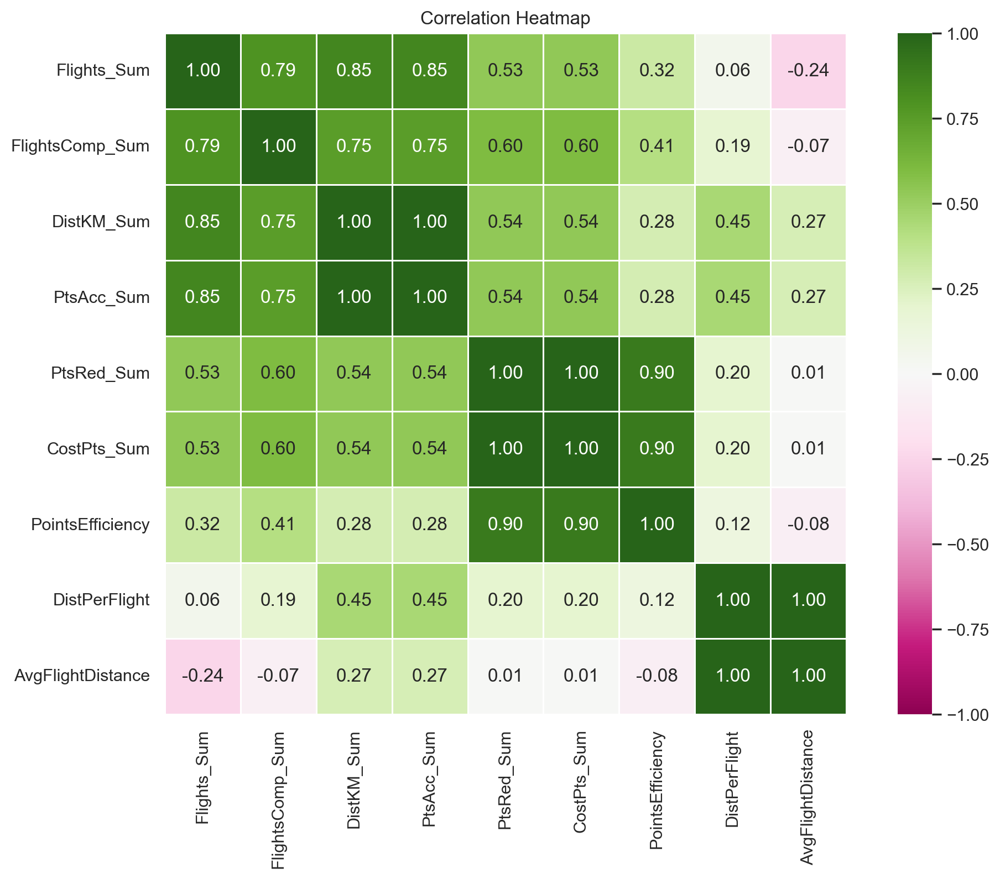

In [93]:
corr_agg = df_f_agg[metric_Sumfeatures_agg].corr(method="spearman")

fig = plt.figure(figsize=(12, 8))
plt.title("Correlation Heatmap")

sns.heatmap(data=corr_agg, 
            annot=True, 
            fmt=".2f", 
            vmin=-1, vmax=1, 
            center=0, 
            square=True, 
            linewidths=.5, 
            cmap='PiYG' 
            )

plt.show()

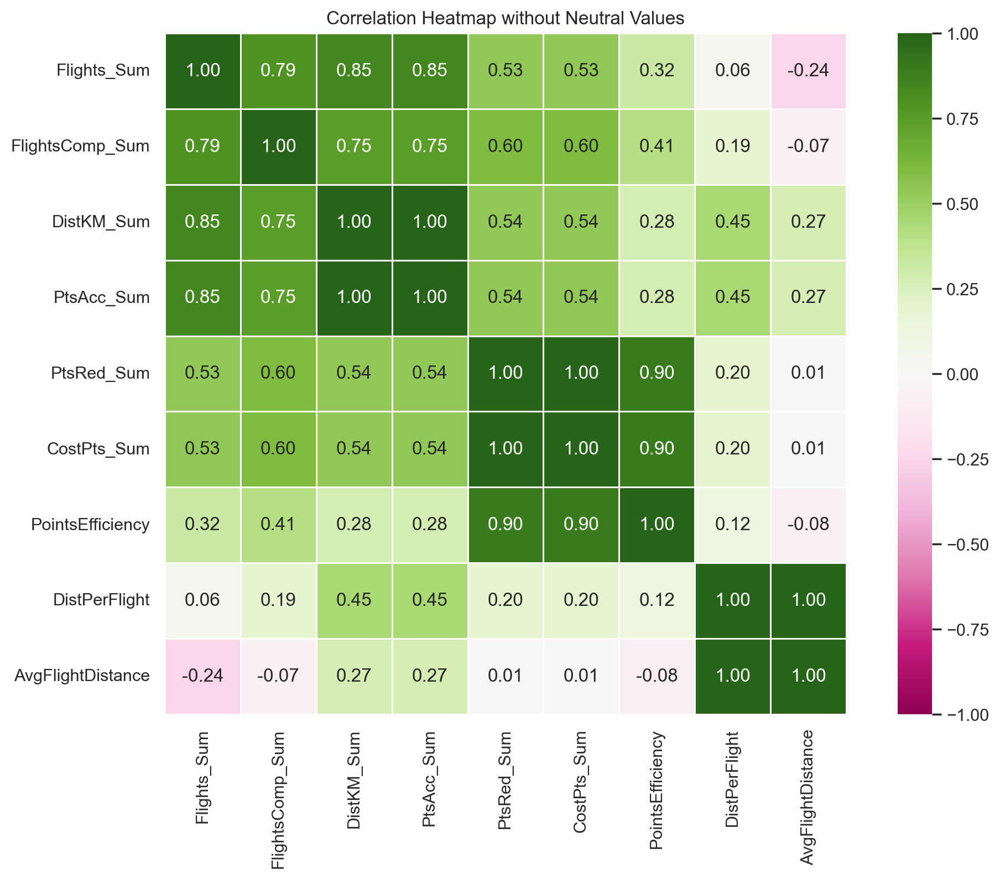

In [94]:
#now without negative/neutral values

df_valid_agg = df_f_agg[metric_Sumfeatures_agg]
df_valid_agg = df_valid_agg[(df_valid_agg > 0).all(axis=1)]

corr_grouped = df_valid_agg[metric_Sumfeatures_agg].corr(method="spearman")

fig = plt.figure(figsize=(12, 8))
plt.title("Correlation Heatmap without Neutral Values")

sns.heatmap(data=corr_agg, 
            annot=True, 
            fmt=".2f", 
            vmin=-1, vmax=1, 
            center=0, 
            square=True, 
            linewidths=.5, 
            cmap='PiYG' 
            )

plt.show()

<a class="anchor" id="18st-bullet">    </a>
### 2.3.2 Categorical-Categorical

In [95]:
from scipy.stats import chi2_contingency


# Get the column names from non_metric_features
non_metric_features_df_c.remove('Country')

for i in range(len(non_metric_features_df_c)):
    for j in range(i + 1, len(non_metric_features_df_c)):
        cat_var = non_metric_features_df_c[i]
        cat_var2 = non_metric_features_df_c[j]
        contingency_table = pd.crosstab(df_c[cat_var], df_c[cat_var2])  # Create contingency table
        chi2, p, dof, expected = chi2_contingency(contingency_table)   # Perform Chi-square test
        display(contingency_table)
        print(f"Chi-square Test of Independence for {cat_var} and {cat_var2}: p-value = {p}")

City,Banff,Calgary,Charlottetown,Dawson Creek,Edmonton,Fredericton,Halifax,Hull,Kelowna,Kingston,...,Thunder Bay,Toronto,Tremblant,Trenton,Vancouver,Victoria,West Vancouver,Whistler,Whitehorse,Winnipeg
Province or State,,,,,,,,,,,,,,,,,,,,,
Alberta,186,192,0,0,498,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
British Columbia,0,0,0,437,0,0,0,0,79,0,...,0,0,0,0,2551,382,308,579,0,0
Manitoba,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,666
New Brunswick,0,0,0,0,0,421,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Newfoundland,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Nova Scotia,0,0,0,0,0,0,529,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Ontario,0,0,0,0,0,0,0,0,0,397,...,251,3326,0,483,0,0,0,0,0,0
Prince Edward Island,0,0,66,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Quebec,0,0,0,0,0,0,0,355,0,0,...,0,0,390,0,0,0,0,0,0,0


Chi-square Test of Independence for Province or State and City: p-value = 0.0


Gender,female,male
Province or State,,
Alberta,511,478
British Columbia,2201,2135
Manitoba,355,311
New Brunswick,316,318
Newfoundland,122,131
Nova Scotia,260,269
Ontario,2653,2707
Prince Edward Island,35,31
Quebec,1627,1622


Chi-square Test of Independence for Province or State and Gender: p-value = 0.7366019928619685


Education,Bachelor,College,Doctor,High School or Below,Master
Province or State,,,,,
Alberta,619,246,33,59,32
British Columbia,2708,1112,193,194,129
Manitoba,409,172,30,38,17
New Brunswick,404,149,38,24,19
Newfoundland,158,65,7,11,12
Nova Scotia,356,116,18,23,16
Ontario,3333,1377,231,251,168
Prince Edward Island,40,19,2,3,2
Quebec,2036,817,153,149,94


Chi-square Test of Independence for Province or State and Education: p-value = 0.8795811664205196


Location Code,Rural,Suburban,Urban
Province or State,,,
Alberta,308,359,322
British Columbia,1477,1452,1407
Manitoba,232,222,212
New Brunswick,197,220,217
Newfoundland,89,87,77
Nova Scotia,178,187,164
Ontario,1773,1810,1777
Prince Edward Island,19,25,22
Quebec,1129,1079,1041


Chi-square Test of Independence for Province or State and Location Code: p-value = 0.7598932969461277


Marital Status,Divorced,Married,Single
Province or State,,,
Alberta,141,590,258
British Columbia,649,2528,1159
Manitoba,99,389,178
New Brunswick,87,382,165
Newfoundland,41,144,68
Nova Scotia,91,307,131
Ontario,801,3103,1456
Prince Edward Island,14,39,13
Quebec,486,1892,871


Chi-square Test of Independence for Province or State and Marital Status: p-value = 0.8248767221551443


LoyaltyStatus,Aurora,Nova,Star
Province or State,,,
Alberta,210,352,427
British Columbia,867,1476,1993
Manitoba,142,207,317
New Brunswick,108,242,284
Newfoundland,47,80,126
Nova Scotia,113,182,234
Ontario,1121,1780,2459
Prince Edward Island,12,19,35
Quebec,648,1085,1516


Chi-square Test of Independence for Province or State and LoyaltyStatus: p-value = 0.1209604207993495


EnrollmentType,2021 Promotion,Standard
Province or State,,
Alberta,69,920
British Columbia,285,4051
Manitoba,43,623
New Brunswick,39,595
Newfoundland,19,234
Nova Scotia,46,483
Ontario,348,5012
Prince Edward Island,2,64
Quebec,249,3000


Chi-square Test of Independence for Province or State and EnrollmentType: p-value = 0.3483478396564617


Gender,female,male
City,,
Banff,99,87
Calgary,91,101
Charlottetown,35,31
Dawson Creek,241,196
Edmonton,262,236
Fredericton,210,211
Halifax,260,269
Hull,185,170
Kelowna,43,36


Chi-square Test of Independence for City and Gender: p-value = 0.714751409588593


Education,Bachelor,College,Doctor,High School or Below,Master
City,,,,,
Banff,113,44,11,12,6
Calgary,115,52,11,7,7
Charlottetown,40,19,2,3,2
Dawson Creek,278,99,19,19,22
Edmonton,316,127,9,30,16
Fredericton,266,101,27,14,13
Halifax,356,116,18,23,16
Hull,211,88,29,15,12
Kelowna,51,22,3,1,2


Chi-square Test of Independence for City and Education: p-value = 0.2931370091873517


Location Code,Rural,Suburban,Urban
City,,,
Banff,55,71,60
Calgary,51,81,60
Charlottetown,19,25,22
Dawson Creek,146,152,139
Edmonton,162,163,173
Fredericton,139,136,146
Halifax,178,187,164
Hull,120,122,113
Kelowna,23,31,25


Chi-square Test of Independence for City and Location Code: p-value = 0.7028961818333085


Marital Status,Divorced,Married,Single
City,,,
Banff,23,114,49
Calgary,28,110,54
Charlottetown,14,39,13
Dawson Creek,65,259,113
Edmonton,74,296,128
Fredericton,58,256,107
Halifax,91,307,131
Hull,66,197,92
Kelowna,13,39,27


Chi-square Test of Independence for City and Marital Status: p-value = 0.5098746331527171


LoyaltyStatus,Aurora,Nova,Star
City,,,
Banff,34,67,85
Calgary,28,69,95
Charlottetown,12,19,35
Dawson Creek,91,150,196
Edmonton,118,176,204
Fredericton,70,156,195
Halifax,113,182,234
Hull,80,109,166
Kelowna,13,28,38


Chi-square Test of Independence for City and LoyaltyStatus: p-value = 0.19138391216772807


EnrollmentType,2021 Promotion,Standard
City,,
Banff,12,174
Calgary,8,184
Charlottetown,2,64
Dawson Creek,25,412
Edmonton,42,456
Fredericton,27,394
Halifax,46,483
Hull,27,328
Kelowna,9,70


Chi-square Test of Independence for City and EnrollmentType: p-value = 0.42963805243651987


Education,Bachelor,College,Doctor,High School or Below,Master
Gender,,,,,
female,5248,2067,368,397,266
male,5138,2141,356,375,238


Chi-square Test of Independence for Gender and Education: p-value = 0.37080539243499605


Location Code,Rural,Suburban,Urban
Gender,,,
female,2816,2799,2731
male,2748,2817,2683


Chi-square Test of Independence for Gender and Location Code: p-value = 0.6922643752085568


Marital Status,Divorced,Married,Single
Gender,,,
female,1251,4837,2258
male,1236,4821,2191


Chi-square Test of Independence for Gender and Marital Status: p-value = 0.7606273575974649


LoyaltyStatus,Aurora,Nova,Star
Gender,,,
female,1680,2860,3806
male,1685,2751,3812


Chi-square Test of Independence for Gender and LoyaltyStatus: p-value = 0.46049797901457645


EnrollmentType,2021 Promotion,Standard
Gender,,
female,574,7772
male,564,7684


Chi-square Test of Independence for Gender and EnrollmentType: p-value = 0.9441861162956983


Location Code,Rural,Suburban,Urban
Education,,,
Bachelor,3482,3536,3368
College,1426,1374,1408
Doctor,229,259,236
High School or Below,258,268,246
Master,169,179,156


Chi-square Test of Independence for Education and Location Code: p-value = 0.6682988922242863


Marital Status,Divorced,Married,Single
Education,,,
Bachelor,1623,7052,1711
College,370,1433,2405
Doctor,180,455,89
High School or Below,124,511,137
Master,190,207,107


Chi-square Test of Independence for Education and Marital Status: p-value = 0.0


LoyaltyStatus,Aurora,Nova,Star
Education,,,
Bachelor,2240,3656,4490
College,783,1319,2106
Doctor,134,242,348
High School or Below,132,245,395
Master,76,149,279


Chi-square Test of Independence for Education and LoyaltyStatus: p-value = 4.0388564839181947e-16


EnrollmentType,2021 Promotion,Standard
Education,,
Bachelor,726,9660
College,285,3923
Doctor,43,681
High School or Below,58,714
Master,26,478


Chi-square Test of Independence for Education and EnrollmentType: p-value = 0.3945641000109691


Marital Status,Divorced,Married,Single
Location Code,,,
Rural,822,3259,1483
Suburban,831,3310,1475
Urban,834,3089,1491


Chi-square Test of Independence for Location Code and Marital Status: p-value = 0.3353157823856363


LoyaltyStatus,Aurora,Nova,Star
Location Code,,,
Rural,1126,1840,2598
Suburban,1162,1901,2553
Urban,1077,1870,2467


Chi-square Test of Independence for Location Code and LoyaltyStatus: p-value = 0.4393769017937761


EnrollmentType,2021 Promotion,Standard
Location Code,,
Rural,372,5192
Suburban,406,5210
Urban,360,5054


Chi-square Test of Independence for Location Code and EnrollmentType: p-value = 0.398659121488794


LoyaltyStatus,Aurora,Nova,Star
Marital Status,,,
Divorced,489,841,1157
Married,2041,3356,4261
Single,835,1414,2200


Chi-square Test of Independence for Marital Status and LoyaltyStatus: p-value = 2.9471334578509677e-07


EnrollmentType,2021 Promotion,Standard
Marital Status,,
Divorced,176,2311
Married,665,8993
Single,297,4152


Chi-square Test of Independence for Marital Status and EnrollmentType: p-value = 0.8067858295077724


EnrollmentType,2021 Promotion,Standard
LoyaltyStatus,,
Aurora,238,3127
Nova,397,5214
Star,503,7115


Chi-square Test of Independence for LoyaltyStatus and EnrollmentType: p-value = 0.487964647877968


<h1>Visualization<h1>

**Province or State by LoyaltyStatus**

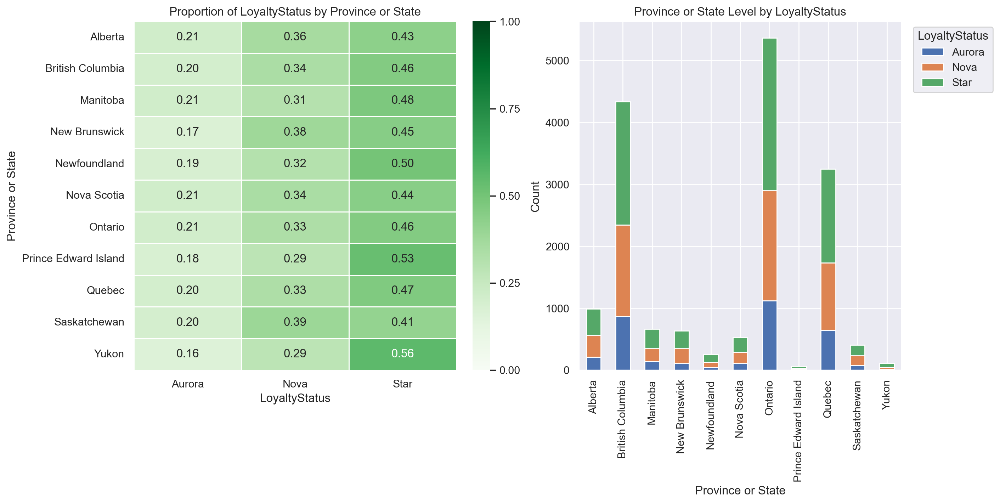

In [96]:
fig, axes = plt.subplots(1, 2, figsize=(14,7), constrained_layout=True)

# --- Heatmap  ---
ct_prop = pd.crosstab(df_c['Province or State'], df_c['LoyaltyStatus'], normalize='index')
sns.heatmap(ct_prop, annot=True, fmt=".2f", cmap="Greens", linewidths=0.5, ax=axes[0], vmin=0, vmax=1,                   # escala fixa 0–1
    cbar_kws={"ticks":[0, .25, .5, .75, 1]}
)
axes[0].set_title("Proportion of LoyaltyStatus by Province or State")
axes[0].set_xlabel("LoyaltyStatus")
axes[0].set_ylabel("Province or State")

# --- Bar plot ---
ct_cnt = pd.crosstab(df_c['Province or State'], df_c['LoyaltyStatus'])
ct_cnt.plot(kind='bar', stacked=True, ax=axes[1])
axes[1].set_title("Province or State Level by LoyaltyStatus")
axes[1].set_xlabel("Province or State")
axes[1].set_ylabel("Count")
axes[1].legend(title="LoyaltyStatus", bbox_to_anchor=(1.02, 1), loc="upper left")

plt.show()

**Education and Marital Status**

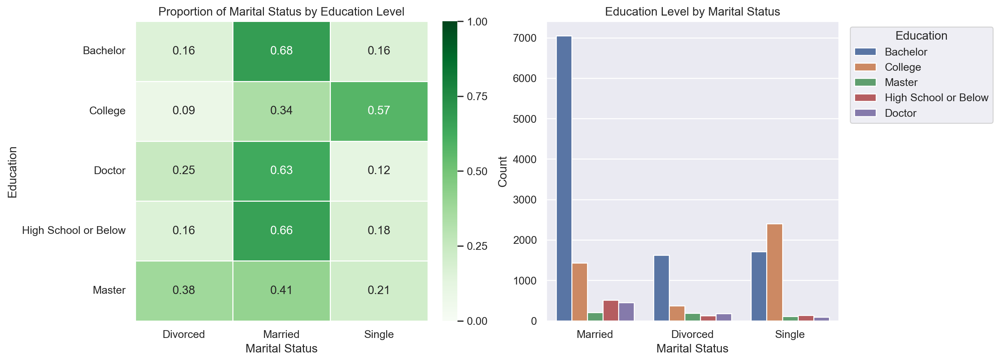

In [97]:
fig, axes = plt.subplots(1, 2, figsize=(14,5), constrained_layout=True)

# --- Heatmap  ---
ct_prop = pd.crosstab(df_c['Education'], df_c['Marital Status'], normalize='index')
sns.heatmap(ct_prop, annot=True, fmt=".2f", cmap="Greens", linewidths=0.5, ax=axes[0], vmin=0, vmax=1,                   # escala fixa 0–1
    cbar_kws={"ticks":[0, .25, .5, .75, 1]}
)
axes[0].set_title("Proportion of Marital Status by Education Level")
axes[0].set_xlabel("Marital Status")
axes[0].set_ylabel("Education")

# --- Bar plot ---
sns.countplot(df_c, x="Marital Status", hue="Education")
axes[1].set_title("Education Level by Marital Status")
axes[1].set_xlabel("Marital Status")
axes[1].set_ylabel("Count")
axes[1].legend(title="Education", bbox_to_anchor=(1.02, 1), loc="upper left")

plt.show()

Education and LoyaltyStatus

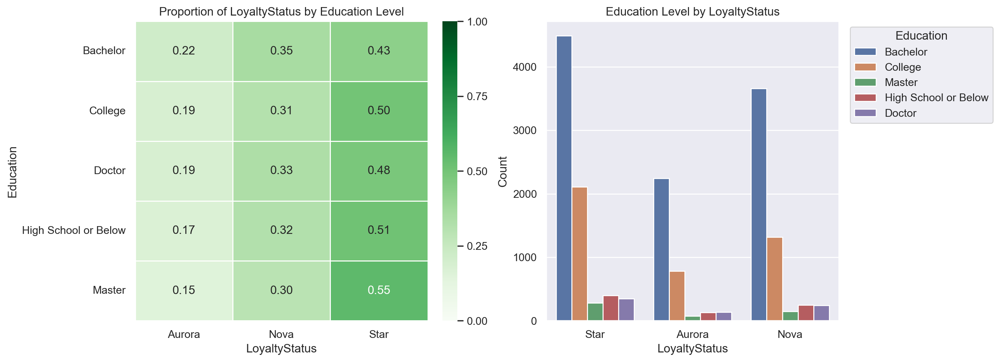

In [98]:
fig, axes = plt.subplots(1, 2, figsize=(14,5), constrained_layout=True)

# --- Heatmap  ---
ct_prop = pd.crosstab(df_c['Education'], df_c['LoyaltyStatus'], normalize='index')
sns.heatmap(ct_prop, annot=True, fmt=".2f", cmap="Greens", linewidths=0.5, ax=axes[0], vmin=0, vmax=1,                   # escala fixa 0–1
    cbar_kws={"ticks":[0, .25, .5, .75, 1]}
)
axes[0].set_title("Proportion of LoyaltyStatus by Education Level")
axes[0].set_xlabel("LoyaltyStatus")
axes[0].set_ylabel("Education")

# --- Bar plot ---
sns.countplot(df_c, x="LoyaltyStatus", hue="Education")
axes[1].set_title("Education Level by LoyaltyStatus")
axes[1].set_xlabel("LoyaltyStatus")
axes[1].set_ylabel("Count")
axes[1].legend(title="Education", bbox_to_anchor=(1.02, 1), loc="upper left")

plt.show()

Marital Status and LoyaltyStatus:

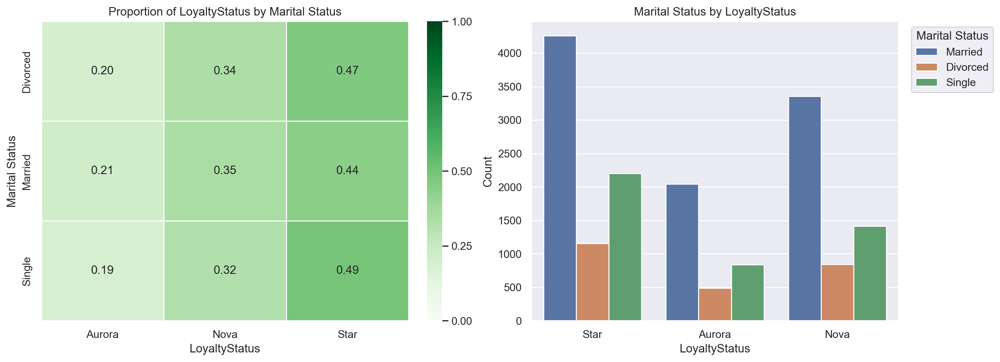

In [99]:
fig, axes = plt.subplots(1, 2, figsize=(14,5), constrained_layout=True)

# --- Heatmap  ---
ct_prop = pd.crosstab(df_c['Marital Status'], df_c['LoyaltyStatus'], normalize='index')
sns.heatmap(ct_prop, annot=True, fmt=".2f", cmap="Greens", linewidths=0.5, ax=axes[0], vmin=0, vmax=1,                   # escala fixa 0–1
    cbar_kws={"ticks":[0, .25, .5, .75, 1]}
)
axes[0].set_title("Proportion of LoyaltyStatus by Marital Status")
axes[0].set_xlabel("LoyaltyStatus")
axes[0].set_ylabel("Marital Status")

# --- Bar plot ---
sns.countplot(df_c, x="LoyaltyStatus", hue="Marital Status")
axes[1].set_title("Marital Status by LoyaltyStatus")
axes[1].set_xlabel("LoyaltyStatus")
axes[1].set_ylabel("Count")
axes[1].legend(title="Marital Status", bbox_to_anchor=(1.02, 1), loc="upper left")

plt.show()

<a class="anchor" id="18st-bullet">    </a>
### 2.3.3 Numeric-Categorical

Average Income, Cutomer Lifetime Value and Days_sub per Province or State

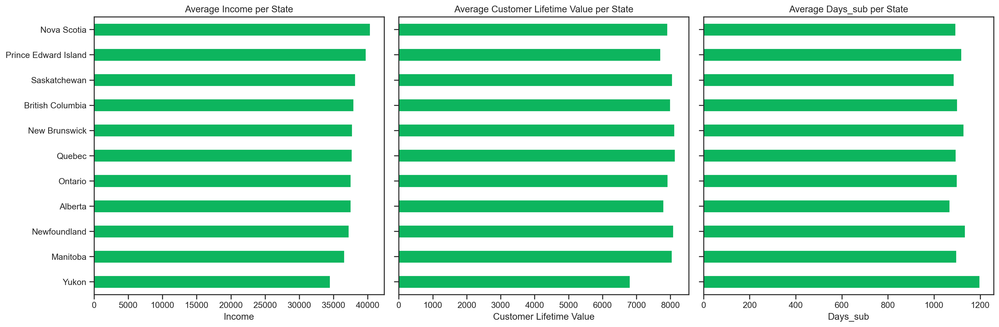

In [100]:
# average income by city barplot
df_c_grouped_state_inc= df_c.groupby('Province or State')['Income'].mean().sort_values(ascending = False)
df_c_grouped_state_clv= df_c.groupby('Province or State')['Customer Lifetime Value'].mean().sort_values(ascending = False)
df_c_grouped_state_days= df_c.groupby('Province or State')['Days_sub'].mean().sort_values(ascending = False)

sns.set(style="ticks")


order = df_c_grouped_state_inc.index
s1 = df_c_grouped_state_inc
s2 = df_c_grouped_state_clv.reindex(order)
s3 = df_c_grouped_state_days.reindex(order)

fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)

for ax, (s, title, xlabel) in zip(
    axes,
    [(s1, "Average Income per State", "Income"),
     (s2, "Average Customer Lifetime Value per State", "Customer Lifetime Value"),
     (s3, "Average Days_sub per State", "Days_sub")]
):
    s.plot(kind="barh", ax=ax, color = "#0DB55E")
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel("")
    ax.invert_yaxis() 

plt.tight_layout()
plt.show()

Boxplots of Income, Cutomer Lifetime Value and Days_sub per Province or State

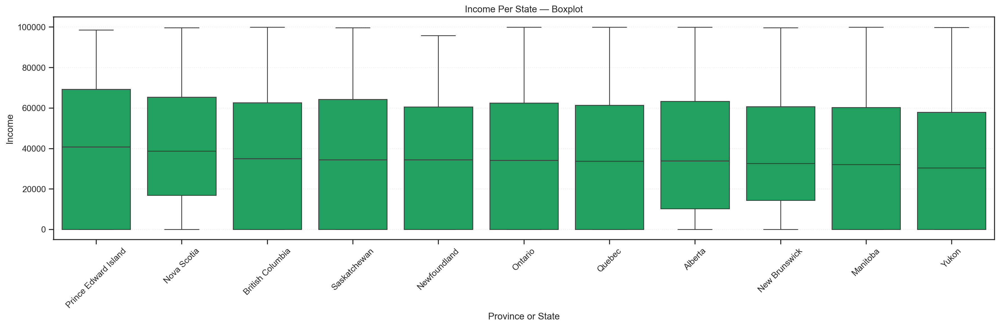

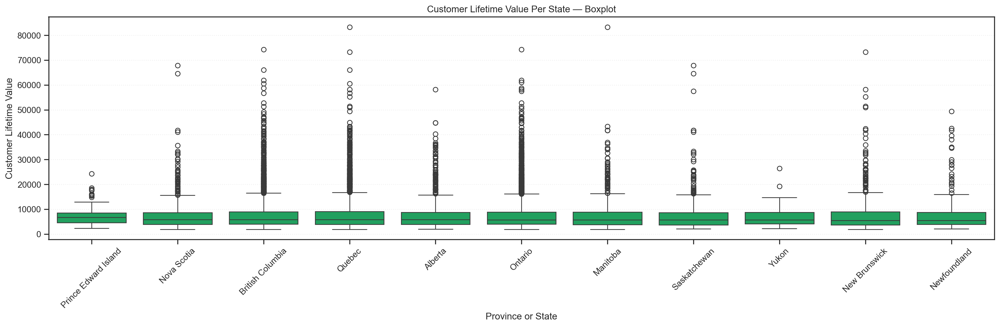

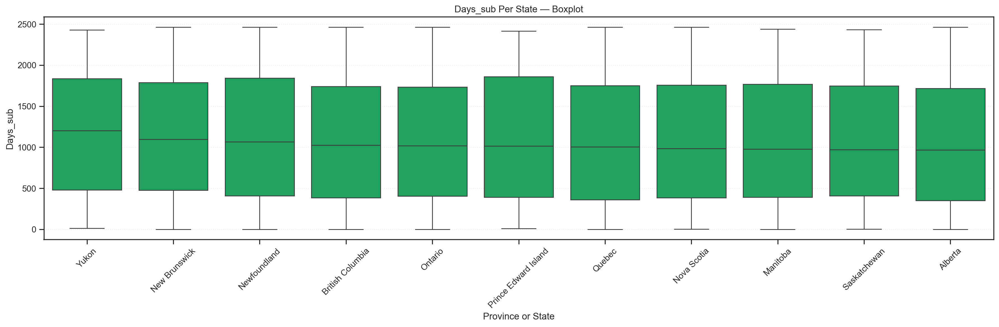

In [101]:
metrics = [
    ('Income', 'Income'),
    ('Customer Lifetime Value', 'Customer Lifetime Value'),
    ('Days_sub', 'Days_sub')
]

for col, label in metrics:

    order = (df_c.groupby('Province or State')[col]
               .median().sort_values(ascending=False).index)

    plt.figure(figsize=(18, 6))
    ax = sns.boxplot(data=df_c, x='Province or State', y=col,
                     order=order, showfliers=True, color = "#0DB55E")
    ax.set_title(f'{label} Per State — Boxplot')
    ax.set_xlabel('Province or State')
    ax.set_ylabel(label)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, axis='y', linestyle=':', alpha=.3)
    plt.tight_layout()

    plt.show()

Average Income, Cutomer Lifetime Value and Days_sub per City

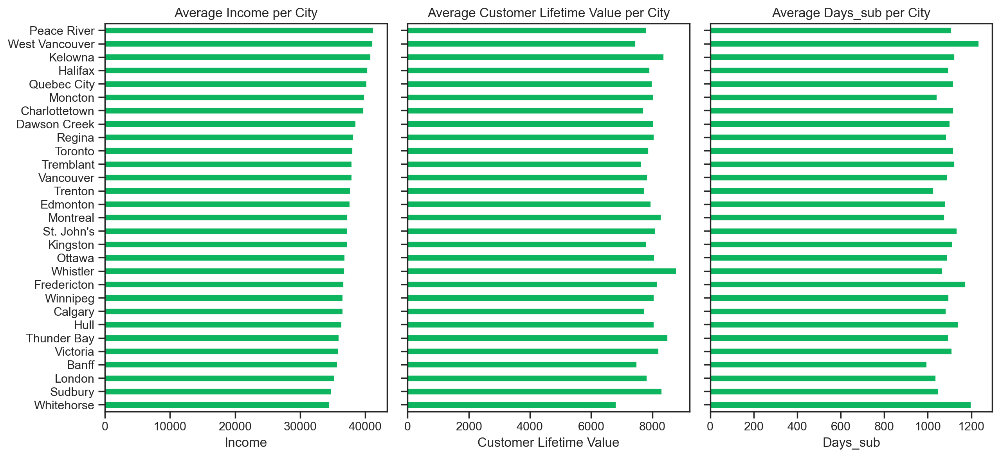

In [102]:
# average income by city barplot
df_c_grouped_state_inc= df_c.groupby('City')['Income'].mean().sort_values(ascending = False)
df_c_grouped_state_clv= df_c.groupby('City')['Customer Lifetime Value'].mean().sort_values(ascending = False)
df_c_grouped_state_days= df_c.groupby('City')['Days_sub'].mean().sort_values(ascending = False)

sns.set(style="ticks")

order = df_c_grouped_state_inc.index
s1 = df_c_grouped_state_inc
s2 = df_c_grouped_state_clv.reindex(order)
s3 = df_c_grouped_state_days.reindex(order)

fig, axes = plt.subplots(1, 3, figsize=(13, 6), sharey=True)

for ax, (s, title, xlabel) in zip(
    axes,
    [(s1, "Average Income per City", "Income"),
     (s2, "Average Customer Lifetime Value per City", "Customer Lifetime Value"),
     (s3, "Average Days_sub per City", "Days_sub")]
):
    s.plot(kind="barh", ax=ax, color = "#0DB55E")
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel("")
    ax.invert_yaxis()

plt.tight_layout()
plt.show()

Boxplots of Income, Cutomer Lifetime Value and Days_sub per City

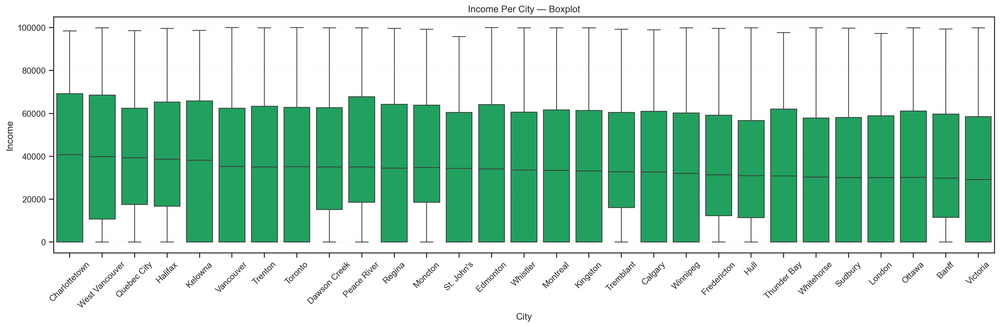

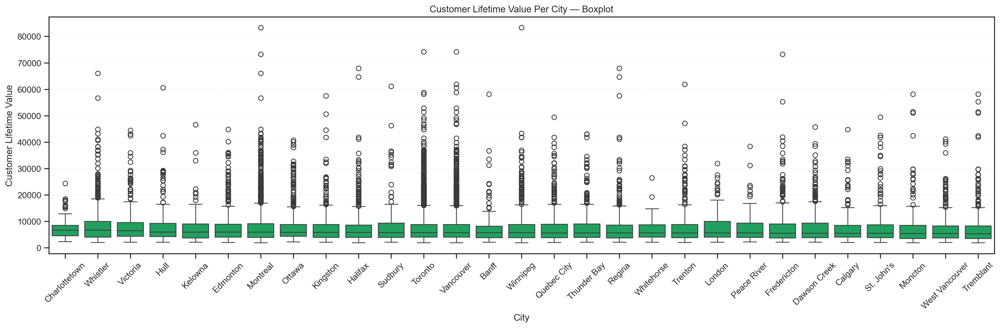

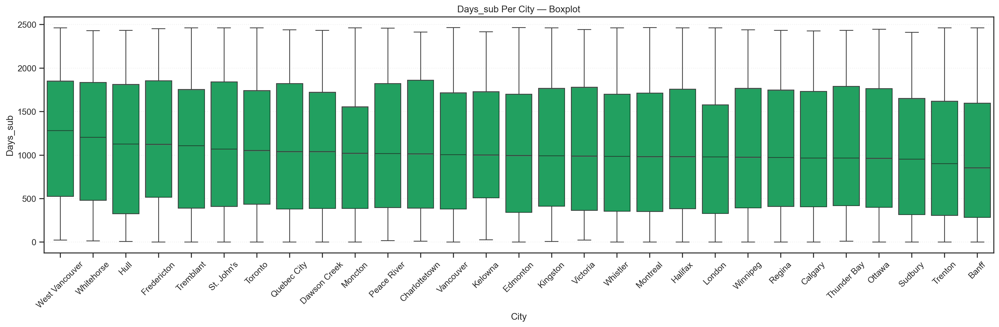

In [103]:
metrics = [
    ('Income', 'Income'),
    ('Customer Lifetime Value', 'Customer Lifetime Value'),
    ('Days_sub', 'Days_sub')
]

for col, label in metrics:

    order = (df_c.groupby('City')[col]
               .median().sort_values(ascending=False).index)

    plt.figure(figsize=(18, 6))
    ax = sns.boxplot(data=df_c, x='City', y=col,
                     order=order, showfliers=True, color = "#0DB55E")
    ax.set_title(f'{label} Per City — Boxplot')
    ax.set_xlabel('City')
    ax.set_ylabel(label)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, axis='y', linestyle=':', alpha=.3)
    plt.tight_layout()

    plt.show()

Average Income, Cutomer Lifetime Value and Days_sub per Education Level

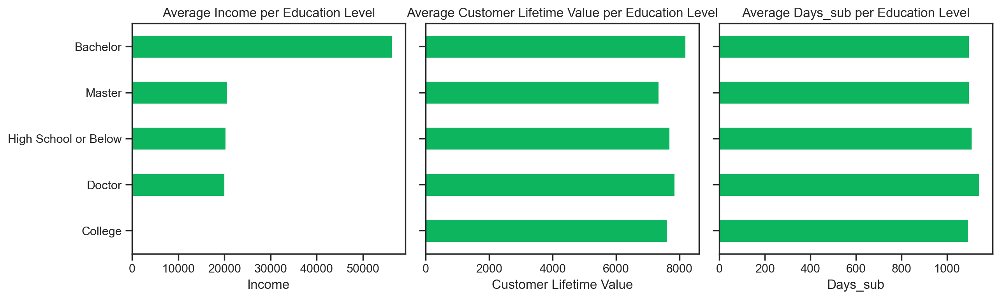

In [104]:
# average income by city barplot
df_c_grouped_state_inc= df_c.groupby('Education')['Income'].mean().sort_values(ascending = False)
df_c_grouped_state_clv= df_c.groupby('Education')['Customer Lifetime Value'].mean().sort_values(ascending = False)
df_c_grouped_state_days= df_c.groupby('Education')['Days_sub'].mean().sort_values(ascending = False)

sns.set(style="ticks")


order = df_c_grouped_state_inc.index
s1 = df_c_grouped_state_inc
s2 = df_c_grouped_state_clv.reindex(order)
s3 = df_c_grouped_state_days.reindex(order)

fig, axes = plt.subplots(1, 3, figsize=(13, 4), sharey=True)

for ax, (s, title, xlabel) in zip(
    axes,
    [(s1, "Average Income per Education Level", "Income"),
     (s2, "Average Customer Lifetime Value per Education Level", "Customer Lifetime Value"),
     (s3, "Average Days_sub per Education Level", "Days_sub")]
):
    s.plot(kind="barh", ax=ax, color = "#0DB55E")
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel("")
    ax.invert_yaxis() 

plt.tight_layout()
plt.show()

Boxplots of Income, Cutomer Lifetime Value and Days_sub per Education

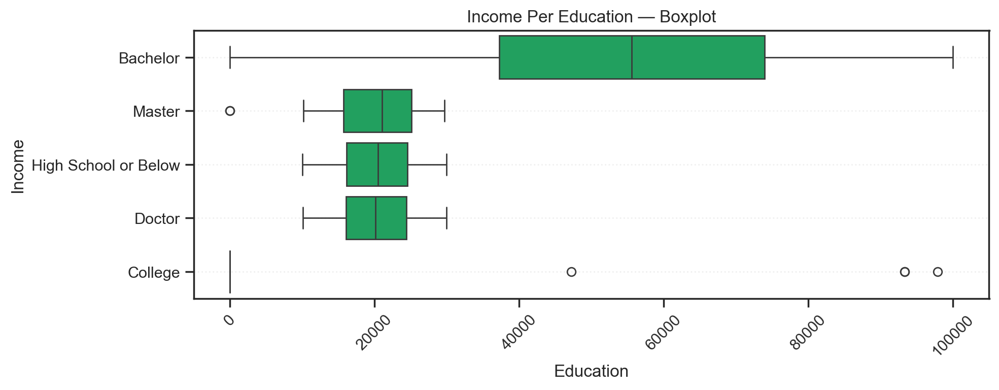

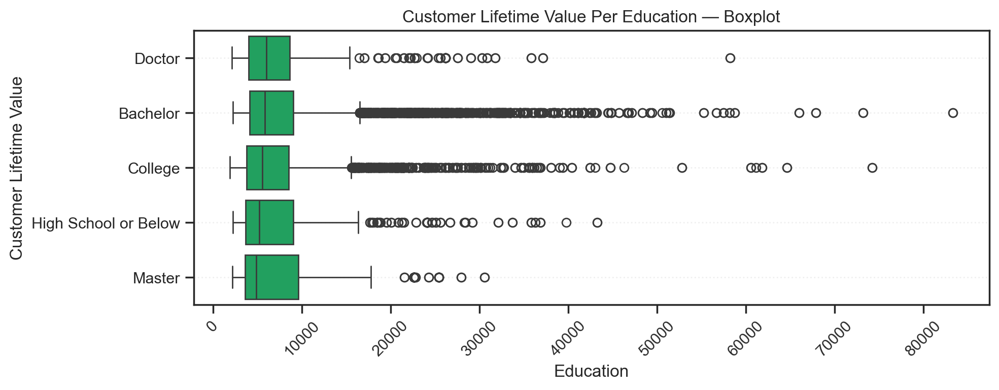

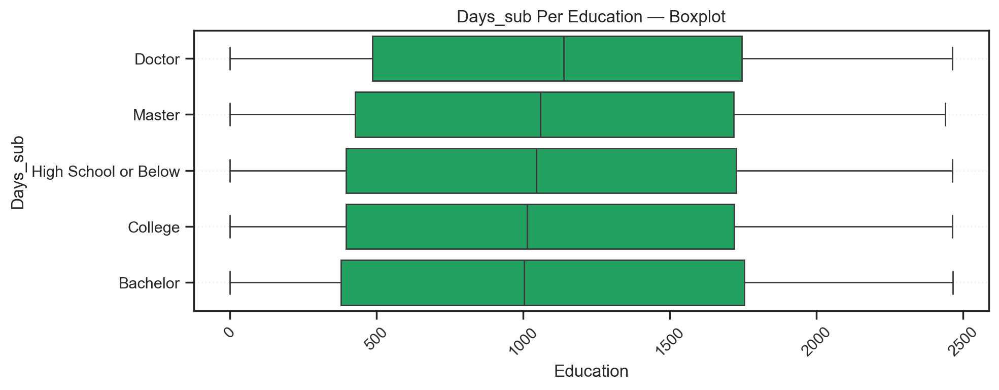

In [105]:
metrics = [
    ('Income', 'Income'),
    ('Customer Lifetime Value', 'Customer Lifetime Value'),
    ('Days_sub', 'Days_sub')
]

for col, label in metrics:

    order = (df_c.groupby('Education')[col]
               .median().sort_values(ascending=False).index)

    plt.figure(figsize=(10, 4))
    ax = sns.boxplot(data=df_c, y='Education', x=col,
                     order=order, showfliers=True, color = "#0DB55E")
    ax.set_title(f'{label} Per Education — Boxplot')
    ax.set_xlabel('Education')
    ax.set_ylabel(label)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, axis='y', linestyle=':', alpha=.3)
    plt.tight_layout()

    plt.show()

Average Income, Cutomer Lifetime Value and Days_sub per LoyaltyStatus

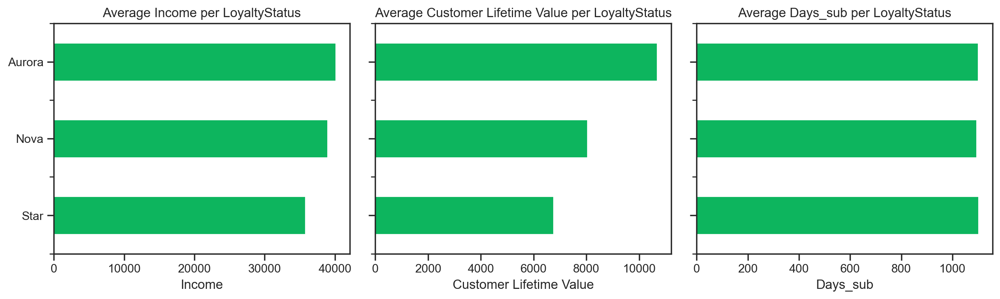

In [106]:
# average income by city barplot
df_c_grouped_state_inc= df_c.groupby('LoyaltyStatus')['Income'].mean().sort_values(ascending = False)
df_c_grouped_state_clv= df_c.groupby('LoyaltyStatus')['Customer Lifetime Value'].mean().sort_values(ascending = False)
df_c_grouped_state_days= df_c.groupby('LoyaltyStatus')['Days_sub'].mean().sort_values(ascending = False)

sns.set(style="ticks")


order = df_c_grouped_state_inc.index
s1 = df_c_grouped_state_inc
s2 = df_c_grouped_state_clv.reindex(order)
s3 = df_c_grouped_state_days.reindex(order)

fig, axes = plt.subplots(1, 3, figsize=(13, 4), sharey=True)

for ax, (s, title, xlabel) in zip(
    axes,
    [(s1, "Average Income per LoyaltyStatus", "Income"),
     (s2, "Average Customer Lifetime Value per LoyaltyStatus", "Customer Lifetime Value"),
     (s3, "Average Days_sub per LoyaltyStatus", "Days_sub")]
):
    s.plot(kind="barh", ax=ax, color = "#0DB55E")
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel("")
    ax.invert_yaxis() 

plt.tight_layout()
plt.show()

Boxplots of Income, Cutomer Lifetime Value and Days_sub per LoyaltyStatus

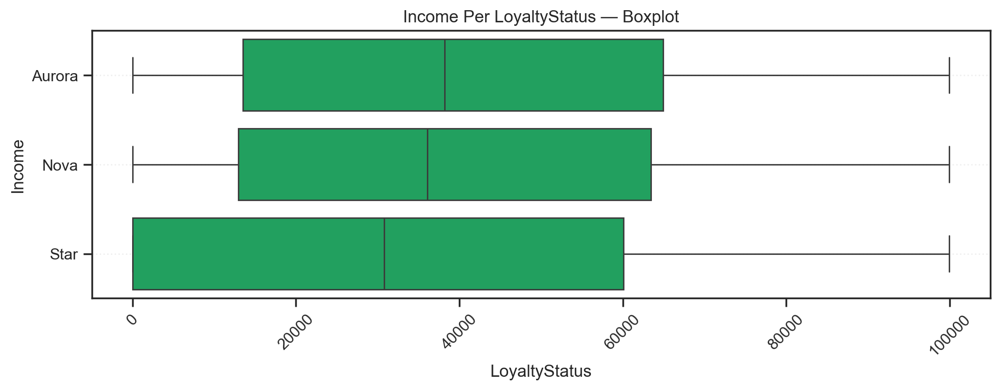

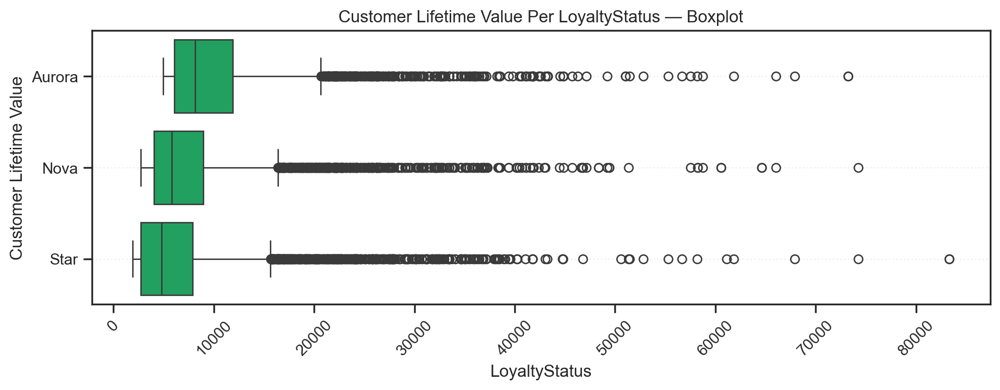

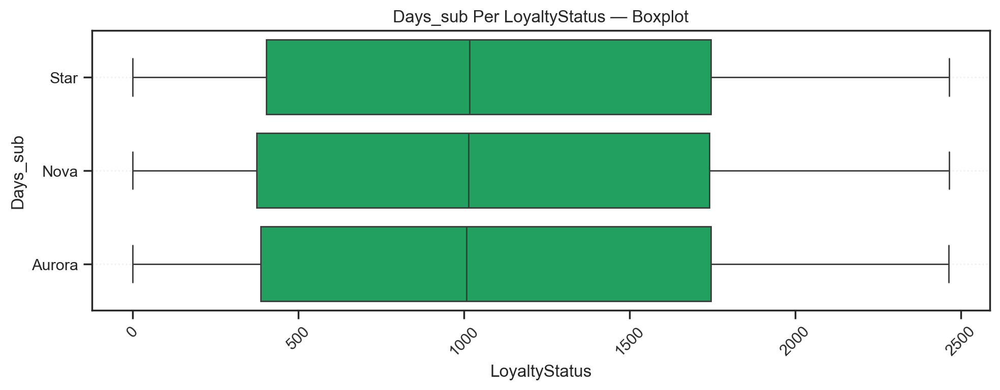

In [107]:
metrics = [
    ('Income', 'Income'),
    ('Customer Lifetime Value', 'Customer Lifetime Value'),
    ('Days_sub', 'Days_sub')
]

for col, label in metrics:

    order = (df_c.groupby('LoyaltyStatus')[col]
               .median().sort_values(ascending=False).index)

    plt.figure(figsize=(10, 4))
    ax = sns.boxplot(data=df_c, y='LoyaltyStatus', x=col,
                     order=order, showfliers=True, color = "#0DB55E")
    ax.set_title(f'{label} Per LoyaltyStatus — Boxplot')
    ax.set_xlabel('LoyaltyStatus')
    ax.set_ylabel(label)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, axis='y', linestyle=':', alpha=.3)
    plt.tight_layout()

    plt.show()

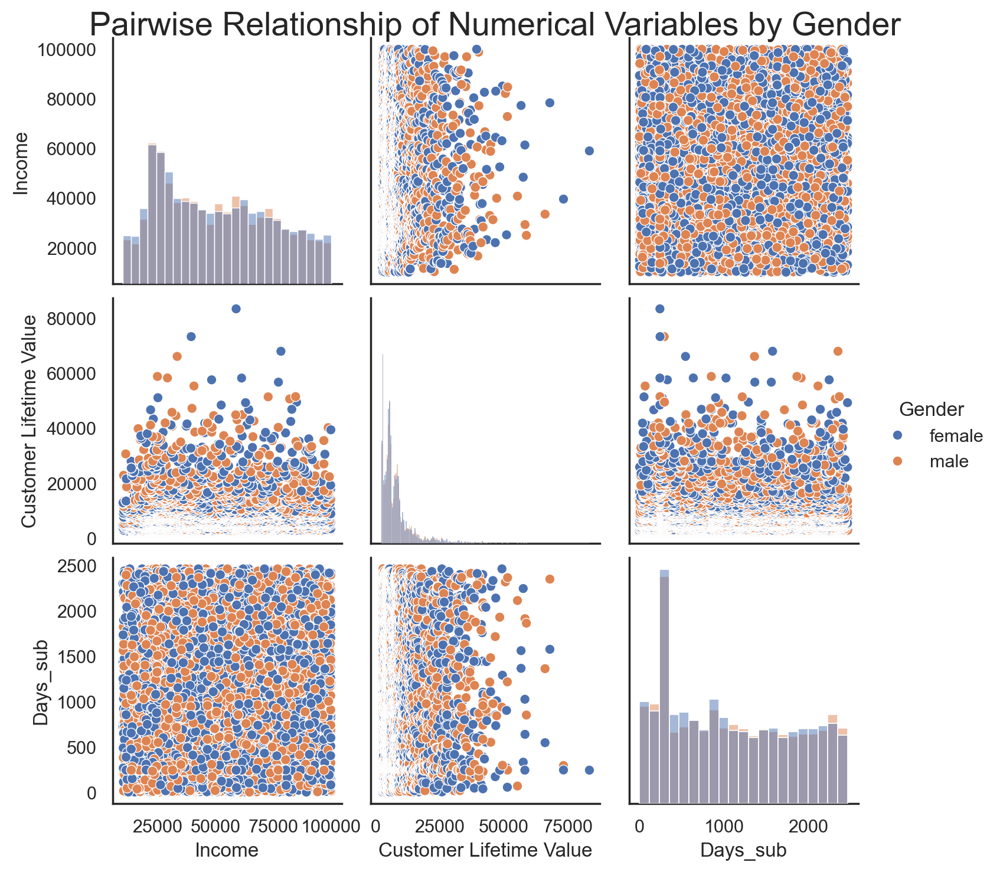

In [108]:
mask = (df_c[metric_features_df_c] > 0).all(axis=1)        
df_valid10 = df_c[mask].copy() 

sns.set(style="white")

sns.pairplot(
    df_valid10[metric_features_df_c + ['Gender']], 
    diag_kind="hist", 
    hue='Gender'
    )

plt.suptitle("Pairwise Relationship of Numerical Variables by Gender", fontsize=20)
plt.subplots_adjust(top=0.95)

plt.show()

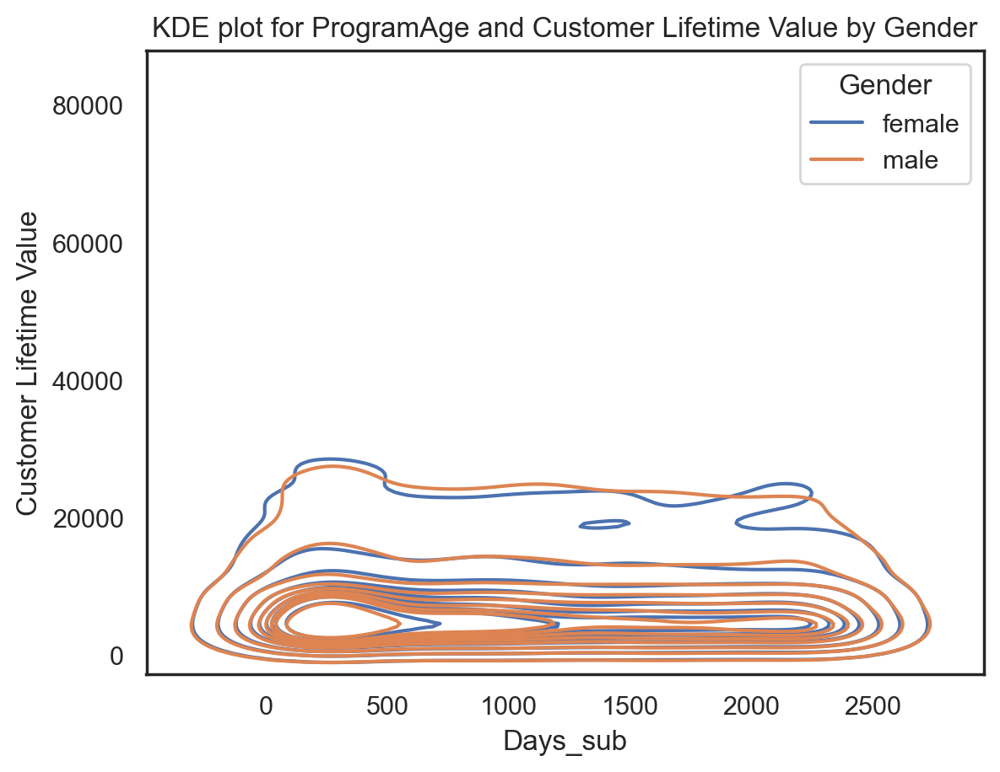

In [109]:
sns.kdeplot(df_c,
            x="Days_sub",
            y="Customer Lifetime Value",            
            hue='Gender')
#title
plt.title("KDE plot for ProgramAge and Customer Lifetime Value by Gender")
plt.show()

**Numeric Variables by year**

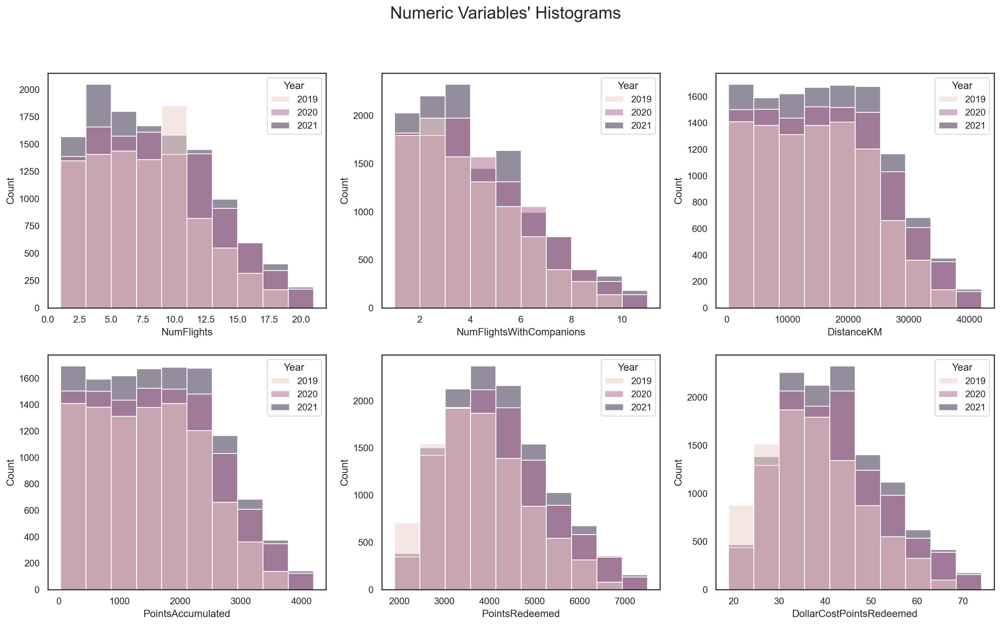

In [110]:
mask_2 = (df_f[metric_features_df_f] > 0).all(axis=1)        
df_valid11 = df_f[mask_2].copy()                   

sns.set(style="white")

sp_rows = 2
sp_cols = 3

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(20, 11))

# Plot data
for ax, feat in zip(axes.flatten(), metric_features_df_f): 
    sns.histplot(df_valid11, x=feat, ax=ax, bins=10, hue='Year')

# Layout
title = "Numeric Variables' Histograms"

plt.suptitle(title, fontsize=20)

plt.show()

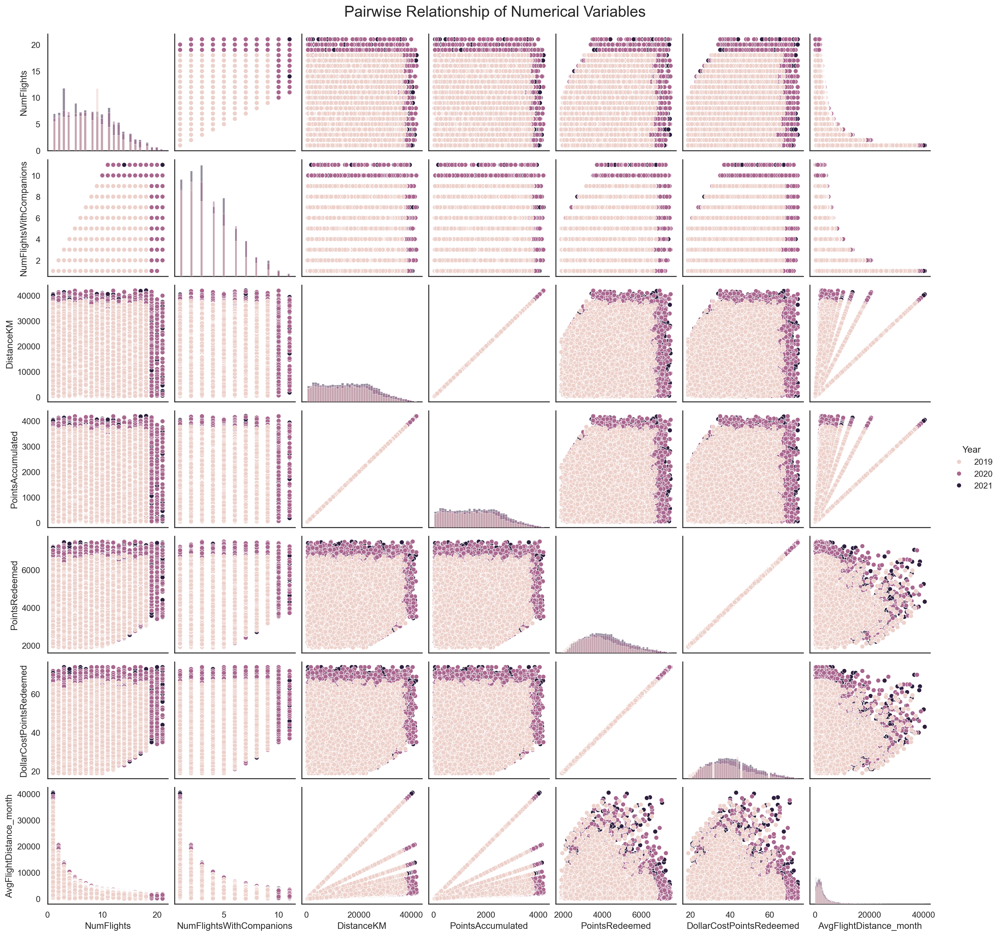

In [111]:
mask_2 = (df_f[metric_features_df_f] > 0).all(axis=1)        
df_valid12 = df_f[mask_2].copy()   

sns.set(style="white")

sns.pairplot(
    df_valid12[metric_features_df_f + ['Year']], 
    diag_kind="hist", 
    hue='Year'
    )

plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)
plt.subplots_adjust(top=0.95)

plt.show()

KeyboardInterrupt: 

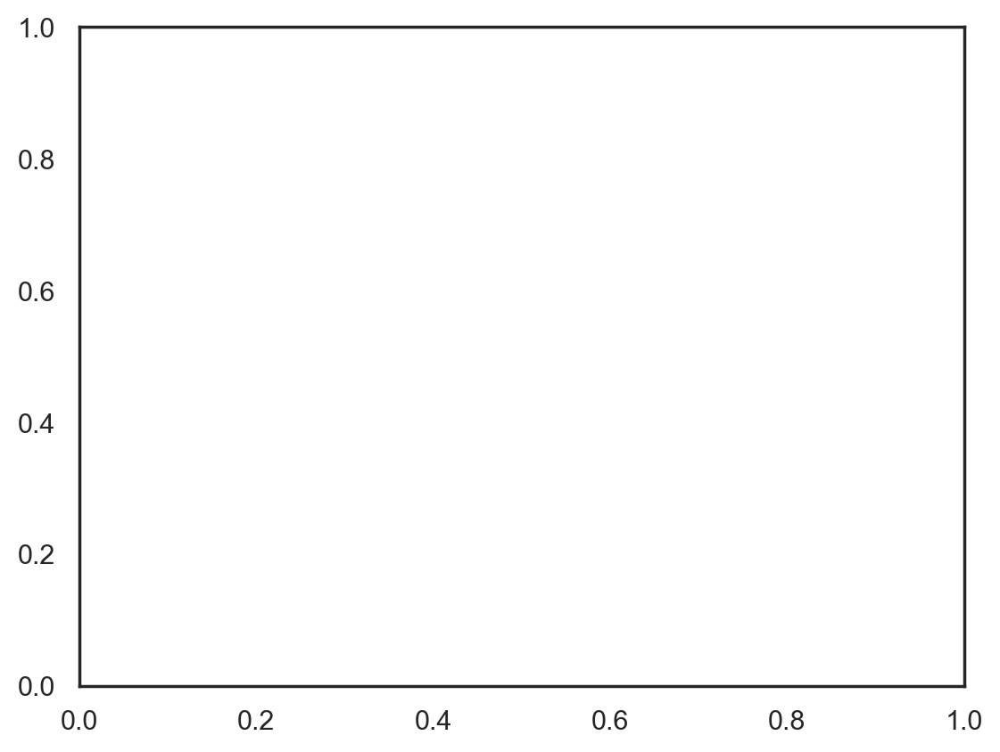

In [112]:
df_valid13 = df_f[
    (df_f['NumFlights'] > 0) &
    (df_f['DistanceKM'] > 0)]

sns.kdeplot(df_valid13,
            x="NumFlights",
            y="DistanceKM",            
            hue='Year')

plt.title("KDE plot for NumFlights and DistanceKM by Year")
plt.show()

<a class="anchor" id="19st-bullet">    </a>
#### 2.3.3.1 Seasonality check

In [ ]:
sorted(df_f['Month'].unique())

[np.int64(1),
 np.int64(2),
 np.int64(3),
 np.int64(4),
 np.int64(5),
 np.int64(6),
 np.int64(7),
 np.int64(8),
 np.int64(9),
 np.int64(10),
 np.int64(11),
 np.int64(12)]

In [ ]:
df_f['Month'].value_counts()

Month
12    49722
6     49722
5     49722
4     49722
3     49722
2     49722
1     49722
11    49722
10    49722
9     49722
8     49722
7     49722
Name: count, dtype: int64

In [ ]:
df_f['Year'].value_counts()

Year
2021    198888
2020    198888
2019    198888
Name: count, dtype: int64

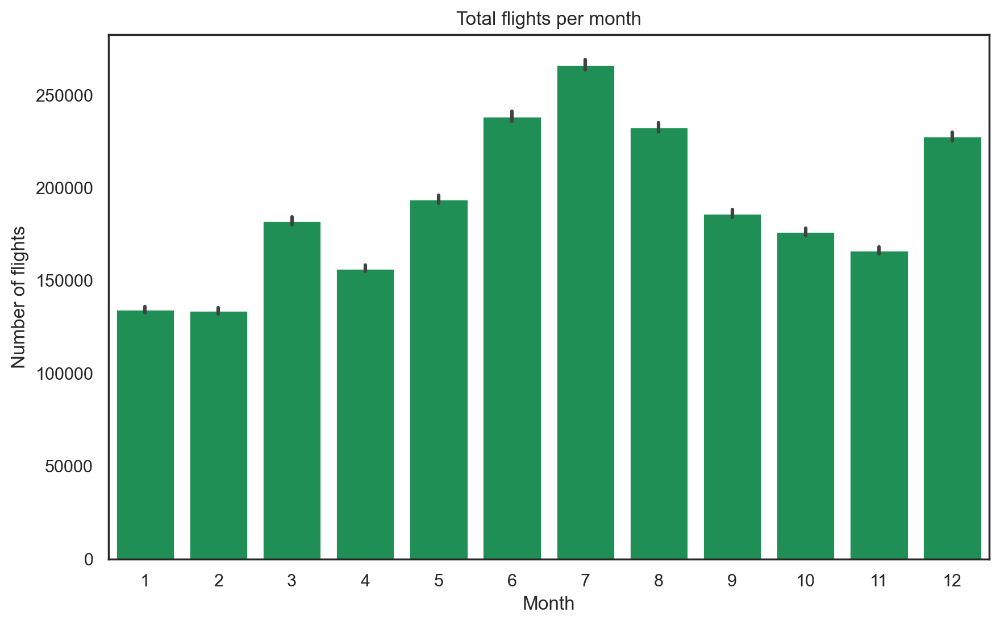

In [ ]:
plt.figure(figsize=(10,6))
sns.barplot(data=df_f, x='Month', y='NumFlights', estimator='sum', color = '#0EA155')  
plt.title('Total flights per month')
plt.xlabel('Month')
plt.ylabel('Number of flights')
plt.show()

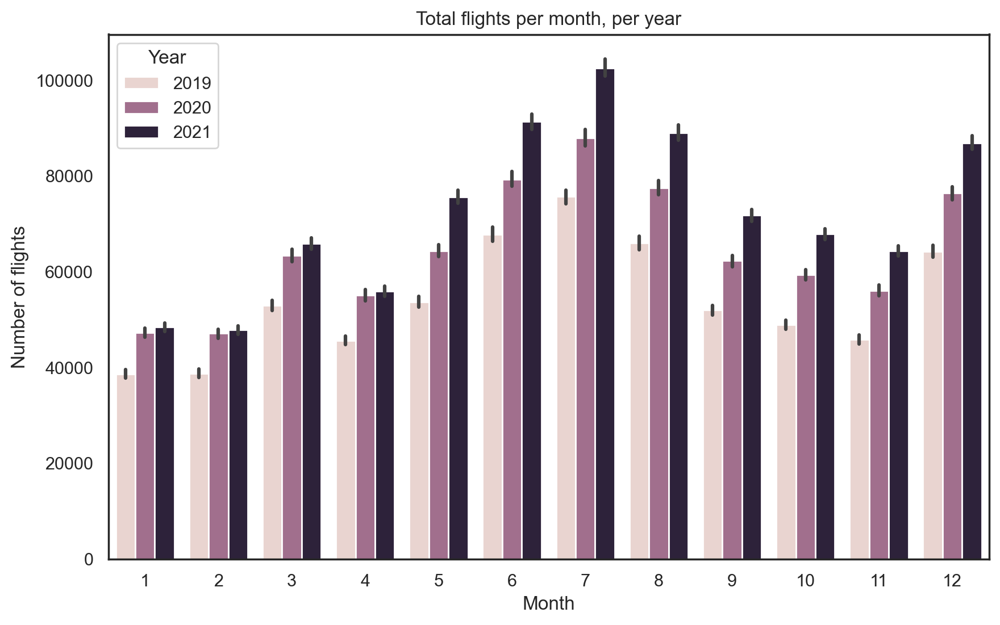

In [ ]:
plt.figure(figsize=(10,6))
sns.barplot(data=df_f, x='Month', y='NumFlights', estimator='sum', hue = 'Year')  
plt.title('Total flights per month, per year')
plt.xlabel('Month')
plt.ylabel('Number of flights')
plt.show()

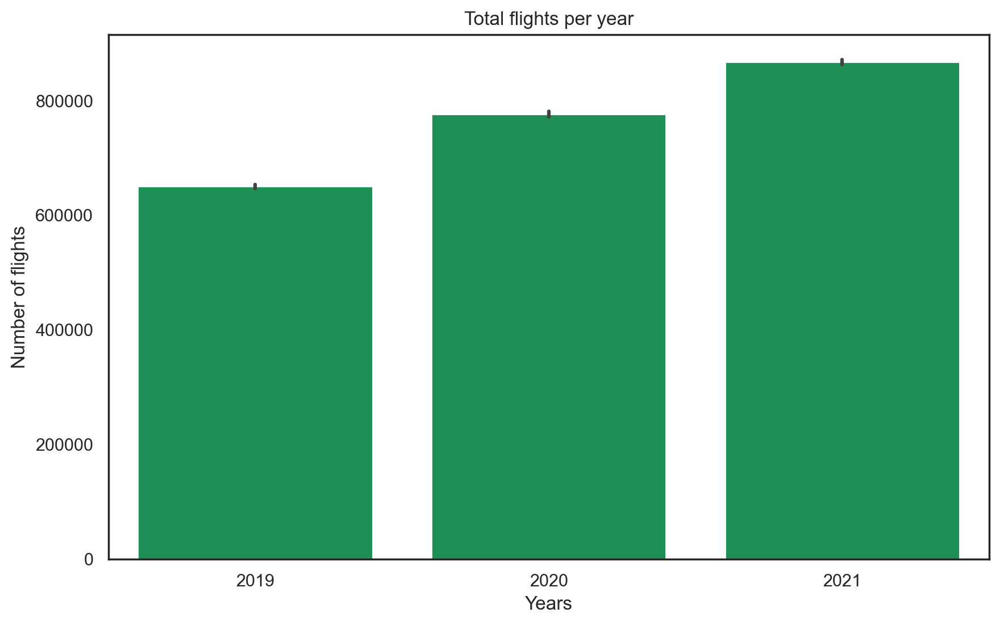

In [ ]:
plt.figure(figsize=(10,6))
sns.barplot(data=df_f, x='Year', y='NumFlights', estimator='sum', color = '#0EA155')  
plt.title('Total flights per year')
plt.xlabel('Years')
plt.ylabel('Number of flights')
plt.show()

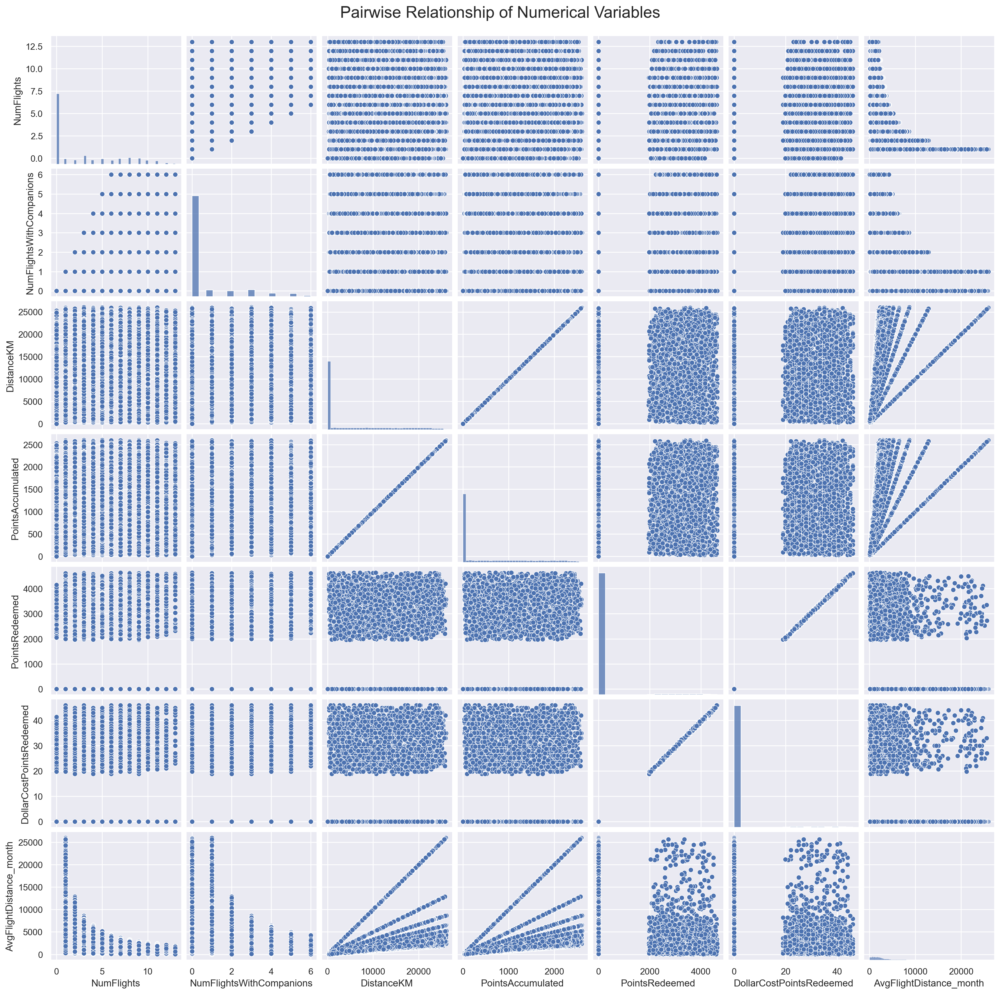

In [ ]:
sns.set()

df_month12 = df_f[df_f['Month'] == 1]

sns.pairplot(df_month12[metric_features_df_f], diag_kind="hist")

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)
plt.show()

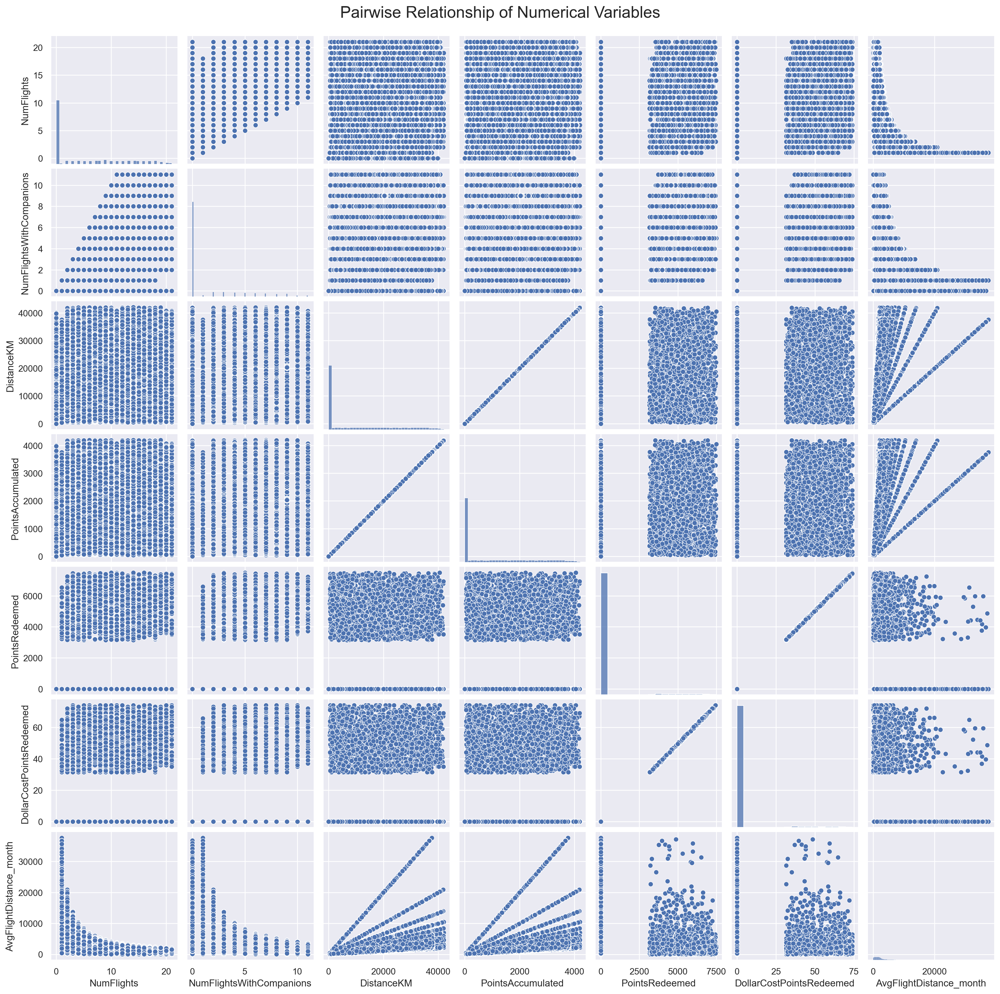

In [ ]:
sns.set()

df_month7 = df_f[df_f['Month'] == 7]

sns.pairplot(df_month7[metric_features_df_f], diag_kind="hist")

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)
plt.show()

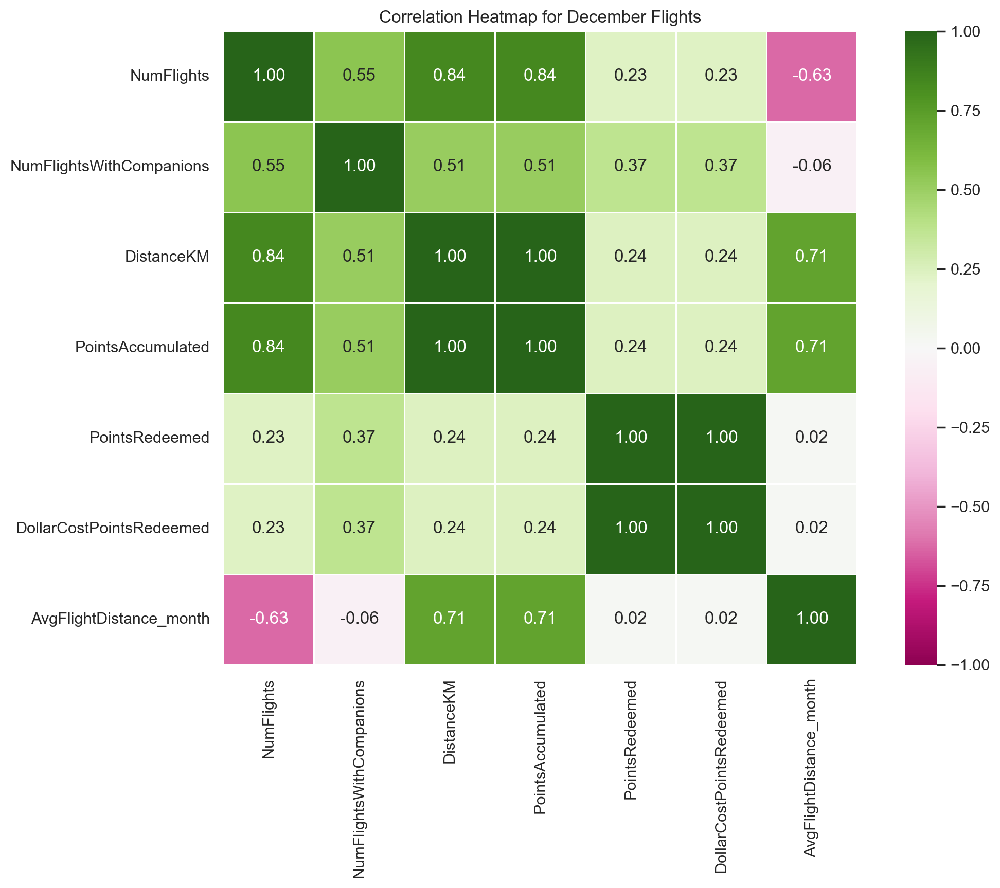

In [ ]:
corr_saz = df_month12[metric_features_df_f].corr(method="spearman")

fig = plt.figure(figsize=(12, 8))
plt.title("Correlation Heatmap for December Flights")

sns.heatmap(data=corr_saz, 
            annot=True, 
            fmt=".2f", 
            vmin=-1, vmax=1, 
            center=0, 
            square=True, 
            linewidths=.5, 
            cmap='PiYG' 
            )

plt.show()

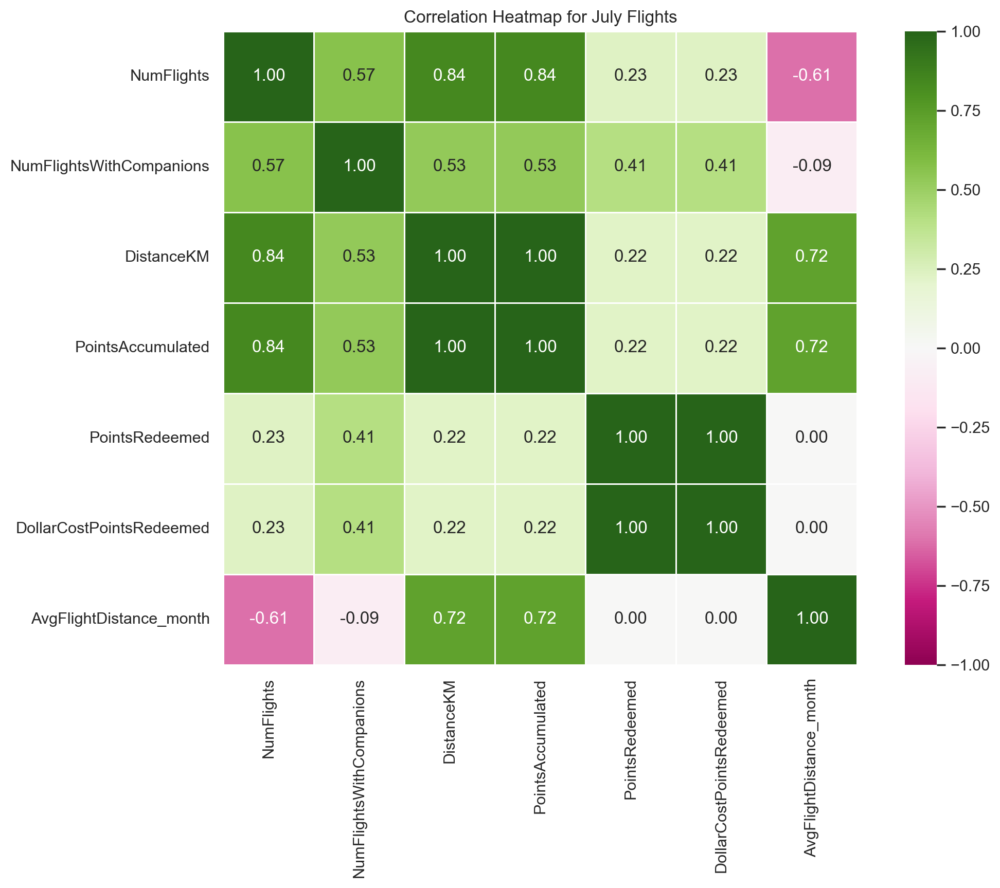

In [ ]:
corr_saz = df_month7[metric_features_df_f].corr(method="spearman")

fig = plt.figure(figsize=(12, 8))
plt.title("Correlation Heatmap for July Flights")

sns.heatmap(data=corr_saz, 
            annot=True, 
            fmt=".2f", 
            vmin=-1, vmax=1, 
            center=0, 
            square=True, 
            linewidths=.5, 
            cmap='PiYG' 
            )

plt.show()


<a class="anchor" id="20st-bullet">    </a>
## 2.4 Outlier Detection

**Merge data sets**

In [ ]:
df_total = pd.merge(df_c, df_f_agg, on="Loyalty#", how="left")

print("Final dimensions:", df_total.shape)

Final dimensions: (16594, 40)


In [ ]:
df_total.columns

Index(['Loyalty#', 'First Name', 'Last Name', 'Customer Name', 'Country',
       'Province or State', 'City', 'Latitude', 'Longitude', 'Postal code',
       'Gender', 'Education', 'Location Code', 'Income', 'Marital Status',
       'LoyaltyStatus', 'EnrollmentDateOpening', 'CancellationDate',
       'Customer Lifetime Value', 'EnrollmentType', 'Days_sub', 'Years_Active',
       'Months_Active', 'Flights_Sum', 'Flights_Mean', 'Flights_Max',
       'FlightsComp_Sum', 'FlightsComp_Mean', 'DistKM_Sum', 'DistKM_Mean',
       'DistKM_Max', 'PtsAcc_Sum', 'PtsAcc_Mean', 'PtsRed_Sum', 'PtsRed_Mean',
       'CostPts_Sum', 'CostPts_Mean', 'PointsEfficiency', 'DistPerFlight',
       'AvgFlightDistance'],
      dtype='object')

In [ ]:
# Select the most informative and important variables
selected_features = ["Income", "Customer Lifetime Value", "Days_sub", "LoyaltyStatus",
                     "Flights_Sum", "DistKM_Sum", "PtsAcc_Sum", "PtsRed_Sum",
                     "PointsEfficiency", "DistPerFlight", "Years_Active", "Months_Active"]
# Copy for Isolation Forest
df_iso = df_total[selected_features].copy()

# Hot enconding for "LoyaltyStatus" as is described in "Metadata.csv"
if df_iso["LoyaltyStatus"].dtype == "object":
    map_loyalty = {"Aurora": 1, "Nova": 2, "Star": 3}
    df_iso["LoyaltyStatus"] = df_iso["LoyaltyStatus"].map(map_loyalty)

# Remove the lines that have Nan (there could be another way not so forced)
df_iso = df_iso.dropna()

# Standardize data-
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_iso)

In [ ]:
df_iso.columns

Index(['Income', 'Customer Lifetime Value', 'Days_sub', 'LoyaltyStatus',
       'Flights_Sum', 'DistKM_Sum', 'PtsAcc_Sum', 'PtsRed_Sum',
       'PointsEfficiency', 'DistPerFlight', 'Years_Active', 'Months_Active'],
      dtype='object')

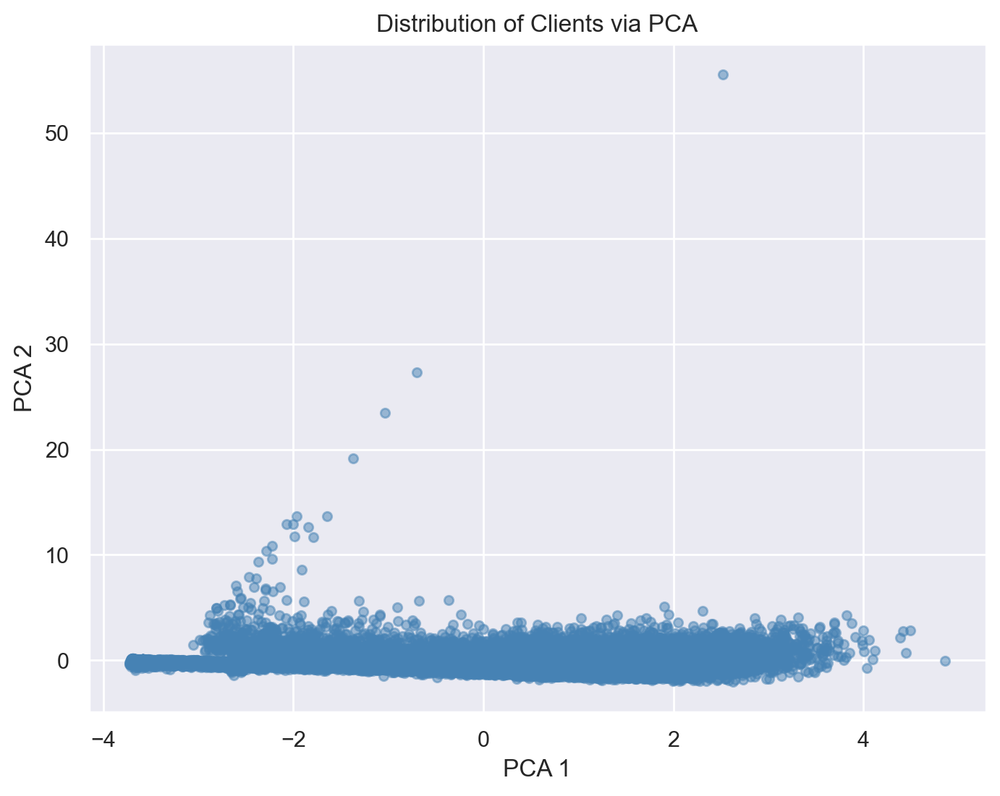

Variance: 49.63%


In [ ]:
# PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

plt.figure(figsize=(8,6))
plt.scatter(X_pca[:,0], X_pca[:,1],
            color="steelblue", alpha=0.5, s=20)
plt.title("Distribution of Clients via PCA")
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.show()

print(f"Variance: {pca.explained_variance_ratio_.sum() * 100:.2f}%")

**Mean difference between outliers and normal clients**

In [ ]:
selected_features

['Income',
 'Customer Lifetime Value',
 'Days_sub',
 'LoyaltyStatus',
 'Flights_Sum',
 'DistKM_Sum',
 'PtsAcc_Sum',
 'PtsRed_Sum',
 'PointsEfficiency',
 'DistPerFlight',
 'Years_Active',
 'Months_Active']

In [ ]:
# It varies when u change the contamination in Isolation Forest (maybe 0.01 is better)
mean_diff_std = (
    (df_iso[df_iso["Outlier"] == -1][selected_features].mean() -
     df_iso[df_iso["Outlier"] == 1][selected_features].mean()) /
     df_iso[df_iso["Outlier"] == 1][selected_features].std()
).sort_values(ascending=False)

mean_diff_std.plot(kind="bar", figsize=(10,5), color="teal")
plt.title("Mean Difference - Outliers vs Normal")
plt.ylabel("Diferença em desvios-padrão")
plt.show()

print(mean_diff_std)

KeyError: 'Outlier'